# Deconditional Kernel Mean Embeddings for Likelihood-Free Inference

This notebook is built on top of the original notebook of a barebone no-frills implementation for Kernel Embedding Likelihood-Free Inference (KELFI) as proposed in:

Kelvin Hsu and Fabio Ramos, 2019, *Bayesian Learning of Conditional Kernel Mean Embeddings for Automatic Likelihood-Free Inference*, in Proceedings of The 22nd International Conference on Artificial Intelligence and Statistics (AISTATS 2019)

It used to only contain:

- Numpy implementations for the core components of KELFI: kernel means likelihood (KML), marginal kernel means likelihood (MKML), kernel means posterior (KMP), kernel means posterior embedding (KMPE), and kernel herding
- Tensorflow implementations with automatic differentiation for gradient-based hyperparameter learning through optimizing MKML
- Demonstration on the toy exponential-gamma problem using only 100 simulations to stress test the posterior approximation, compared to other surrogate-based approaches
- See Section 5.1 in the paper for a discussion on the exponential-gamma experiment

In this version, we further include a barebone no-frills implementation for Deconditional Kernel Mean Embeddings when applied to Likelihood-Free-Inference as proposed in:

Kelvin Hsu and Fabio Ramos, 2019, *Bayesian Deconditional Kernel Mean Embeddings*, in Proceedings of The 36th International Conference on Machine Learning (ICML 2019)

To ensure that this notebook is 100% reproducible. We have provided at the last cell of this notebook all the library package versions used in the virtual environment for running this notebook.

In [1]:
%%file kernels.py
"""
Kernel Module.

Basic functions used for computing anisotropic Gaussian kernels.

Note: Matern and other kernels were removed from this version, since they were not used in the experiments in the end.
"""
import numpy as np


def sqdist_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of euclidean distances between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : np.ndarray [Size: (n_p, d)]
        A dataset
    x_q : np.ndarray [Size: (n_q, d)]
        A dataset
    length_scale : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    np.ndarray [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, d)
    z_p = np.atleast_2d(x_p) / length_scale
    # Size: (n_q, d)
    z_q = np.atleast_2d(x_q) / length_scale
    # Size: (n_p, n_q)
    d_pq = np.dot(z_p, z_q.transpose())
    # Size: (n_p,)
    d_p = np.sum(z_p ** 2, axis=1)
    # Size: (n_q,)
    d_q = np.sum(z_q ** 2, axis=1)
    # Size: (n_p, n_q)
    return d_p[:, np.newaxis] - 2 * d_pq + d_q


def gaussian_kernel_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of Gaussian kernel values between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : np.ndarray [Size: (n_p, d)]
        A dataset
    x_q : np.ndarray [Size: (n_q, d)]
        A dataset
    length_scale : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    np.ndarray [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, n_q)
    return np.exp(-0.5 * sqdist_gramix(x_p, x_q, length_scale))


def convert_anisotropic(length_scale, d):
    """
    Convert isotropic length scale format to anisotropic length scale format.
    
    Parameters
    ----------
    length_scale : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
    d : int
        The dimensionality of the anisotropic kernel
    
    Returns
    -------
    np.ndarray [Size: (d,)]
        The anisotropic length scale(s)
    """
    # Size: (1,) or (d,)
    length_scale_array = np.atleast_1d(length_scale)
    # Make sure it is not more than 1 dimensional
    assert length_scale_array.ndim == 1
    # Make sure it is either isotropic or anisotropic
    assert length_scale_array.shape[0] in [1, d]
    # Convert it to anistropic only if it is isotropic or keep it the same
    if length_scale_array.shape[0] == 1:
        return np.repeat(length_scale_array, d)
    else:
        return length_scale_array

    
def gaussian_density_gramix(x, mu, sigma):
    """
    Compute a gram matrix of Gaussian density values of a dataset for multiple means.
    Parameters
    ----------
    x : np.ndarray [Size: (n, d)]
        A dataset
    mu : np.ndarray [Size: (m, d)]
        A dataset
    sigma : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    np.ndarray [Size: (n, m)]
        The resulting gram matrix
    """
    # Compute the scaling factor of a diagonal multivariate Gaussian distribution
    d = x.shape[-1]
    const = (np.sqrt(2 * np.pi) ** d) * np.prod(convert_anisotropic(sigma, d))
    # Size: (n, m)
    return gaussian_kernel_gramix(x, mu, sigma) / const


def gaussian_density_gramix_multiple(x, mu, sigma):
    """
    Compute the average gram matrix of Gaussian density values of a dataset for multiple arrays of means.
    
    Parameters
    ----------
    x : np.ndarray [Size: (r, n, d)]
        A dataset
    mu : np.ndarray [Size: (m, s, d)]
        A dataset where the average is to be taken over the middle dimension (s)
    sigma : float or np.ndarray [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    np.ndarray [Size: (n, m)]
        The resulting gram matrix
    """    
    # Obtain and ensure the shape matches
    x = np.atleast_2d(x)
    r, n, d = x.shape
    m, s, d = mu.shape
    assert d == x.shape[-1]
    assert d == mu.shape[-1]
    # Size: (r * n, d)
    x_2d = np.reshape(x, (r * n, d))
    # Size: (m * s, d)
    mu_2d = np.reshape(mu, (m * s, d))
    # Size: (r * n, m * s)
    gramix_2d = gaussian_density_gramix(x_2d, mu_2d, sigma)
    # Size: (r, n, m, s)
    gramix_4d = np.reshape(gramix_2d, (r, n, m, s))
    # Size: (n, m)
    # return np.mean(np.prod(gramix_4d, axis=1), axis=-1)
    return np.prod(np.mean(gramix_4d, axis=-1), axis=1)

Overwriting kernels.py


In [2]:
%%file kernel_means_inference.py
"""
Kernel Means Inference Module.

Core methods for likelihood-free inference with kernel means.
"""
import numpy as np
import scipy.linalg as la
from kernels import gaussian_kernel_gramix, gaussian_density_gramix_multiple, gaussian_density_gramix, convert_anisotropic


def kernel_means_weights(y, x_sim, theta_sim, eps, beta, reg=None):
    """
    Compute the weights of the kernel means likelihood.
    
    Parameters
    ----------
    y : np.ndarray [size: (1, d)]
        Observed data or summary statistics
    x_sim : np.ndarray [size: (m, s, d)]
        Simulated data or summary statistics
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    eps : float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
        The simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    reg : float, optional
        The regularization parameter for the conditional kernel mean
        
    Returns
    -------
    np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    """
    # size: (m, 1)
    if x_sim.ndim == 3:
        data_epsilon_likelihood = gaussian_density_gramix_multiple(y, x_sim, eps).transpose()
    elif x_sim.ndim == 2:
        data_epsilon_likelihood = gaussian_density_gramix(y, x_sim, eps).transpose()
    else:
        raise ValueError('Simulated dataset is neither 2D or 3D.')
    
    # The number of simulations
    m = theta_sim.shape[0]
    
    # Set the regularization hyperparameter to some default value if not specified
    if reg is None:
        reg = 1e-3 * np.min(beta)
        
    # Compute the weights at O(m^3)
    theta_sim_gramix = gaussian_kernel_gramix(theta_sim, theta_sim, beta)
    lower = True
    theta_sim_gramix_cholesky = la.cholesky(theta_sim_gramix + m * reg * np.eye(m), lower=lower)
    weights = la.cho_solve((theta_sim_gramix_cholesky, lower), data_epsilon_likelihood)
    
    # size: (m, 1)
    return weights


def kernel_means_likelihood(theta_query, theta_sim, weights, beta):
    """
    Query the kernel means likelihood.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    np.ndarray [size: (n_query,)]
        The kernel means likelihood values at the query points
    """
    # size: (m, n_query)
    theta_evaluation_gramix = gaussian_kernel_gramix(theta_sim, theta_query, beta)
    
    # size: (n_query,)
    return np.dot(theta_evaluation_gramix.transpose(), weights).ravel()


def marginal_kernel_means_likelihood(theta_sim, weights, beta, prior_mean=None, prior_std=None):
    """
    Compute the marginal kernel means likelihood under a diagonal Gaussian prior.
    
    Parameters
    ----------
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_mean : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
        
    Returns
    -------
    float
        The marginal kernel means likelihood
    """
    # By defaut, the prior has zero mean
    if prior_mean is None:
        prior_mean = np.zeros((1, theta_sim.shape[-1]))
        
    # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
    if prior_std is None:
        prior_std = beta

    # Compute the final length scale and the ratio scalar coefficient of the resulting prior mean embedding 
    prior_embedding_length_scale = np.sqrt(beta ** 2 + prior_std ** 2)
    ratio = np.prod(convert_anisotropic(beta / prior_embedding_length_scale, theta_sim.shape[1]))
        
    # Compute the prior mean embedding [size: (m, 1)]
    prior_mean_embedding = ratio * gaussian_kernel_gramix(theta_sim, np.atleast_2d(prior_mean), prior_embedding_length_scale)
    
    # Compute the kernel means marginal likelihood
    return np.dot(prior_mean_embedding.ravel(), weights.ravel())


def approximate_marginal_kernel_means_likelihood(theta_samples, theta_sim, weights, beta):
    """
    Compute the approximate marginal kernel means likelihood using prior samples.
    
    Parameters
    ----------
    theta_samples : np.ndarray [size: (n_samples, p)]
        The parameters samples to marginalize over
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    float
        The approximate marginal kernel means likelihood
    """  
    return np.mean(kernel_means_likelihood(theta_samples, theta_sim, weights, beta))


def kernel_means_posterior(theta_query, theta_sim, weights, beta, prior_pdf, marginal_likelihood):
    """
    Query the kernel means posterior.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_pdf : callable
        The prior probability density function
    marginal_likelihood: float
        The pre-computed marginal kernel means likelihood
        
    Returns
    -------
    np.ndarray [size: (n_query,)]
        The kernel means likelihood values at the query points
    """
    return kernel_means_likelihood(theta_query, theta_sim, weights, beta) * prior_pdf(theta_query).ravel() / marginal_likelihood
  

def kernel_means_posterior_embedding(theta_query, theta_sim, weights, beta, prior_mean=None, prior_std=None, marginal_likelihood=None):
    """
    Compute the kernel means posterior embedding.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_mean : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
    marginal_likelihood : float, optional
        The marginal likelihood value if it was precomputed
    """
    # By defaut, the prior has zero mean
    if prior_mean is None:
        prior_mean = np.zeros((1, theta_sim.shape[-1]))
        
    # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
    # Compute the final length scale of the resulting prior mean embedding
    if prior_std is None:
        prior_std = beta
        
    # Anisotropic constants
    sigma = convert_anisotropic(prior_std, theta_sim.shape[1])
    s = 1 / np.sqrt(2 / (beta ** 2) + 1 / (sigma ** 2))
    gamma = convert_anisotropic(beta / sigma, theta_sim.shape[1])
    denom = 2 + (gamma ** 2)
    
    # Broadcast: (m, d) -> (1, m, d)
    theta_sim_broad = theta_sim[np.newaxis, :, :]
    
    # Broadcast: (q, d) -> (q, 1, d)
    theta_query_broad = theta_query[:, np.newaxis, :]
    
    # Compute the quadratic term in the exponent with size: (q, m, d)
    first = theta_query_broad ** 2 + theta_sim_broad ** 2 + (gamma * prior_mean) **2
    second = theta_query_broad + theta_sim + gamma ** 2 * prior_mean
    c = first / denom - (second / denom) ** 2
    
    # Perform the integral and multiple each dimension to get size: (q, m)
    h = np.prod((s / sigma) * np.exp(- 0.5 * c / (s ** 2)), axis=-1)
    
    # Compute the marginal likelihood if it has not been computed already
    if marginal_likelihood is None:
        marginal_likelihood = kernel_means_marginal_likelihood(theta_sim, weights, beta, prior_mean=prior_mean, prior_std=prior_std)
    
    # size: (q,)
    return np.dot(h, weights).ravel() / marginal_likelihood


def approximate_kernel_means_posterior_embedding(theta_query, theta_sim, weights, beta, theta_samples, marginal_likelihood=None, beta_query=None):
    """
    Compute the approximate kernel means posterior embedding.
    
    Parameters
    ----------
    theta_query : np.ndarray [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : np.ndarray [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    theta_samples : np.ndarray [size: (n_samples, p)]
        The parameters samples to marginalize over
    marginal_likelihood : float, optional
        The marginal likelihood value if it was precomputed
    """
    # Approximate the integral empirically with size: (q, m)
    if beta_query is None:
        beta_query = beta
    h = np.dot(gaussian_kernel_gramix(theta_query, theta_samples, beta_query), gaussian_kernel_gramix(theta_samples, theta_sim, beta)) / theta_samples.shape[0]
    
    # Compute the marginal likelihood if it has not been computed already
    if marginal_likelihood is None:
        marginal_likelihood = approximate_marginal_kernel_means_likelihood(theta_samples, theta_sim, weights, beta)
        
    # size: (q,)
    return np.dot(h, weights).ravel() / marginal_likelihood
    
    
def kernel_herding(mean_embedding_values_or_function, kernel_function, samples, n_super_samples, init_super_samples=None):
    """
    Obtain super samples via kernel herding.
    
    Parameters
    ----------
    mean_embedding_values_or_function : callable or np.ndarray [size: (n_samples,)]
        An mean embedding function of one argument or the mean embedding values queried at the samples
    kernel_function : callable
        A kernel function of two arguments on samples
    samples : np.ndarray (n_samples, n_dim)
        The original samples to samples from
    n_super_samples : int
        The number of super samples to obtain
    init_super_samples : np.ndarray [size: (n_init_super_samples, n_dim)], optional
        The super samples already obtained if one wants to continue sampling instead of restarting the herd
    """
    # Initialize the super samples
    if init_super_samples is None:
        n_init_super_samples = 0
        super_samples = np.zeros((n_super_samples, samples.shape[1]))
    else:
        n_init_super_samples = init_super_samples.shape[0]
        super_samples[:n_init_super_samples] = init_super_samples
    
    # Obtain the mean embedding quried at the samples
    if type(mean_embedding_values_or_function) is callable:
        mu = embedding_values_or_function(samples)
    else:
        mu = mean_embedding_values_or_function
        assert mu.shape[0] == samples.shape[0]
        
    # Perform standard kernel herding
    mu_hat_sum = 0
    for i in range(n_init_super_samples, n_super_samples):
        mu_hat = mu_hat_sum / (i + 1)
        objective = mu - mu_hat
        super_samples[i] = samples[np.argmax(objective)]
        mu_hat_sum += kernel_function(super_samples[[i]], samples).ravel()

    # size : (n_super_samples, n_dim)
    return super_samples

Overwriting kernel_means_inference.py


In [3]:
%%file utils.py
"""
Utils Module.

Miscellaneous methods that are helpful.
"""
import numpy as np
import ghalton as gh

def halton_sequence(n_points=1, n_dims=1):
    """
    Generate Quasi Monte Carlo samples using the Halton sequence.
    
    Parameters
    ----------
    n_points : int
        The number of data points to generate
    n_dims : int
        The number of dimensions to generate the samples in

    Returns
    -------
    numpy.ndarray
        A dataset of size (n_points, n_dims)
    """
    sequencer = gh.Halton(n_dims)
    points = np.array(sequencer.get(n_points))
    return points

Overwriting utils.py


In [4]:
%%file tensorflow_kernels.py
"""
Kernel Module.

Basic functions used for computing anisotropic Gaussian kernels.

Note: Matern and other kernels were removed from this version, since they were not used in the experiments in the end.
"""
import tensorflow as tf
import numpy as np


def sqdist_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of euclidean distances between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : tf.Tensor [Size: (n_p, d)]
        A dataset
    x_q : tf.Tensor [Size: (n_q, d)]
        A dataset
    length_scale : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    tf.Tensor [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, d)
    z_p = x_p / length_scale
    # Size: (n_q, d)
    z_q = x_q / length_scale
    # Size: (n_p, n_q)
    d_pq = tf.matmul(z_p, tf.transpose(z_q))
    # Size: (n_p,)
    d_p = tf.reduce_sum(z_p ** 2, axis=1)
    # Size: (n_q,)
    d_q = tf.reduce_sum(z_q ** 2, axis=1)
    # Size: (n_p, n_q)
    return d_p[:, tf.newaxis] - 2 * d_pq + d_q


def gaussian_kernel_gramix(x_p, x_q, length_scale):
    """
    Compute a gram matrix of Gaussian kernel values between two datasets under an isotropic or anisotropic length scale.
    
    Parameters
    ----------
    x_p : tf.Tensor [Size: (n_p, d)]
        A dataset
    x_q : tf.Tensor [Size: (n_q, d)]
        A dataset
    length_scale : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
        
    Returns
    -------
    tf.Tensor [Size: (n_p, n_q)]
        The resulting gram matrix
    """
    # Size: (n_p, n_q)
    return tf.exp(-0.5 * sqdist_gramix(x_p, x_q, length_scale))


def atleast_1d(tensor):
    """
    Convert a tensor to at least 1 dimensional (equivalent to np.atleast_1d).
    
    Parameters
    ----------
    tensor : tf.Tensor
        A tensor
    
    Returns
    -------
    tf.Tensor
        A tensor of at least 1 dimension
    """
    return tf.reshape(tensor, [1]) if len(tensor.get_shape()) == 0 else tensor


def atleast_2d(tensor):
    """
    Convert a tensor to at least 2 dimensional (equivalent to np.atleast_2d).
    
    Parameters
    ----------
    tensor : tf.Tensor
        A tensor
    
    Returns
    -------
    tf.Tensor
        A tensor of at least 2 dimension
    """
    return tf.reshape(tensor, [1, 1]) if len(tensor.get_shape()) == 0 else tf.reshape(tensor, [1, tensor.get_shape().as_list()[-1]])


def convert_anisotropic(length_scale, d):
    """
    Convert isotropic length scale format to anisotropic length scale format.
    
    Parameters
    ----------
    length_scale : tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The length scale(s)
    d : int
        The dimensionality of the anisotropic kernel
    
    Returns
    -------
    tf.Tensor [Size: (d,)]
        The anisotropic length scale(s)
    """
    # Size: (1,) or (d,)
    length_scale_array = atleast_1d(length_scale)
    # Make sure it is not more than 1 dimensional
    assert len(length_scale_array.get_shape()) == 1
    # Make sure it is either isotropic or anisotropic
    assert length_scale_array.get_shape().as_list()[0] in [1, d]
    # Convert it to anistropic only if it is isotropic or keep it the same
    if length_scale_array.get_shape().as_list()[0] == 1:
        return tf.tile(length_scale_array, [d])
    else:
        return length_scale_array

    
def gaussian_density_gramix(x, mu, sigma):
    """
    Compute a gram matrix of Gaussian density values of a dataset for multiple means.
    Parameters
    ----------
    x : tf.Tensor [Size: (n, d)]
        A dataset
    mu : tf.Tensor [Size: (m, d)]
        A dataset
    sigma : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    tf.Tensor [Size: (n, m)]
        The resulting gram matrix
    """
    # Compute the scaling factor of a diagonal multivariate Gaussian distribution
    d = mu.get_shape().as_list()[-1]
    const = (tf.sqrt(2 * np.pi) ** d) * tf.reduce_prod(convert_anisotropic(sigma, d))
    # Size: (n, m)
    return gaussian_kernel_gramix(x, mu, sigma) / const


def gaussian_density_gramix_multiple(x, mu, sigma):
    """
    Compute the average gram matrix of Gaussian density values of a dataset for multiple arrays of means.
    
    Parameters
    ----------
    x : tf.Tensor [Size: (r, n, d)]
        A dataset
    mu : tf.Tensor [Size: (m, s, d)]
        A dataset where the average is to be taken over the middle dimension (s)
    sigma : float or tf.Tensor [Size: () or (1,) for isotropic; (d,) for anistropic]
        The standard deviations(s)
        
    Returns
    -------
    tf.Tensor [Size: (n, m)]
        The resulting gram matrix
    """    
    # Obtain and ensure the shape matches
    r, n, d = tuple(x.get_shape().as_list())
    m, s, d = tuple(mu.get_shape().as_list())
    assert d == x.get_shape().as_list()[-1]
    assert d == mu.get_shape().as_list()[-1]
    # Size: (r * n, d)
    x_2d = tf.reshape(x, [r * n, d])
    # Size: (m * s, d)
    mu_2d = tf.reshape(mu, [m * s, d])
    # Size: (r * n, m * s)
    gramix_2d = gaussian_density_gramix(x_2d, mu_2d, sigma)
    # Size: (r, n, m, s)
    gramix_4d = tf.reshape(gramix_2d, [r, n, m, s])
    # Size: (n, m)
    # return tf.reduce_mean(tf.reduce_prod(gramix_4d, axis=1), axis=-1)
    return tf.reduce_prod(tf.reduce_mean(gramix_4d, axis=-1), axis=1)

Overwriting tensorflow_kernels.py


In [5]:
%%file kernel_means_learning.py
"""
Kernel Means Learning Module.

Core methods for Bayesian learning of hyperparameters for likelihood-free inference with kernel means.
"""
import numpy as np
import tensorflow as tf
from tensorflow_kernels import gaussian_kernel_gramix, gaussian_density_gramix_multiple, gaussian_density_gramix, convert_anisotropic, atleast_2d


def kernel_means_weights(y, x_sim, theta_sim, eps, beta, reg=None):
    """
    Compute the weights of the kernel means likelihood.
    
    Parameters
    ----------
    y : tf.Tensor [size: (1, d)]
        Observed data or summary statistics
    x_sim : tf.Tensor [size: (m, s, d)]
        Simulated data or summary statistics
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    eps : float or tf.Tensor [size: () or (1,) for isotropic; (d,) for anistropic]
        The simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    reg : float, optional
        The regularization parameter for the conditional kernel mean
        
    Returns
    -------
    tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    """
    # size: (m, 1)
    if len(x_sim.get_shape().as_list()) == 3:
        data_epsilon_likelihood = tf.transpose(gaussian_density_gramix_multiple(y, x_sim, eps))
    elif len(x_sim.get_shape().as_list()) == 2:
        data_epsilon_likelihood = tf.transpose(gaussian_density_gramix(y, x_sim, eps))
    else:
        raise ValueError('Simulated dataset is neither 2D or 3D.')
        
    # The number of simulations
    m = theta_sim.get_shape().as_list()[0]
    
    # Set the regularization hyperparameter to some default value if not specified
    if reg is None:
        reg = 1e-3 * tf.reduce_min(beta)
        
    # Compute the weights at O(m^3)
    theta_sim_gramix = gaussian_kernel_gramix(theta_sim, theta_sim, beta)
    theta_sim_gramix_cholesky = tf.cholesky(theta_sim_gramix + m * reg * tf.eye(m))
    weights = tf.cholesky_solve(theta_sim_gramix_cholesky, data_epsilon_likelihood)
    
    # size: (m, 1)
    return weights


def kernel_means_likelihood(theta_query, theta_sim, weights, beta):
    """
    Query the kernel means likelihood.
    
    Parameters
    ----------
    theta_query : tf.Tensor [size: (n_query, p)]
        The parameters to query the likelihood at
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    tf.Tensor [size: (n_query,)]
        The kernel means likelihood values at the query points
    """
    # size: (m, n_query)
    theta_evaluation_gramix = gaussian_kernel_gramix(theta_sim, theta_query, beta)
    
    # size: (n_query,)
    return tf.squeeze(tf.matmul(tf.transpose(theta_evaluation_gramix), weights))


def marginal_kernel_means_likelihood(theta_sim, weights, beta, prior_mean=None, prior_std=None):
    """
    Compute the marginal kernel means likelihood under a diagonal Gaussian prior.
    
    Parameters
    ----------
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
    prior_mean : tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
        
    Returns
    -------
    float
        The marginal kernel means likelihood
    """
    # By defaut, the prior has zero mean
    if prior_mean is None:
        prior_mean = tf.zeros((1, theta_sim.get_shape().as_list()[-1]))
        
    # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
    if prior_std is None:
        prior_std = beta

    # Compute the final length scale and the ratio scalar coefficient of the resulting prior mean embedding 
    prior_embedding_length_scale = tf.sqrt(beta ** 2 + prior_std ** 2)
    ratio = tf.reduce_prod(convert_anisotropic(beta / prior_embedding_length_scale, theta_sim.get_shape().as_list()[1]))
        
    # Compute the prior mean embedding [size: (m, 1)]
    prior_mean_embedding = ratio * gaussian_kernel_gramix(theta_sim, atleast_2d(prior_mean), prior_embedding_length_scale)
    
    # Compute the kernel means marginal likelihood
    return tf.reduce_sum(tf.multiply(prior_mean_embedding, weights))


def approximate_marginal_kernel_means_likelihood(theta_samples, theta_sim, weights, beta):
    """
    Compute the approximate marginal kernel means likelihood using prior samples.
    
    Parameters
    ----------
    theta_samples : tf.Tensor [size: (n_samples, p)]
        The prior parameter samples to marginalize over
    theta_sim : tf.Tensor [size: (m, p)]
        Parameter values corresponding to the simulations
    weights : tf.Tensor [size: (m, 1)]
        The weights of the kernel means likelihood
    beta : float or tf.Tensor [size: () or (1,) for isotropic; (p,) for anistropic]
        The length scale(s) for the parameter kernel
        
    Returns
    -------
    float
        The approximate marginal kernel means likelihood   
    """
    return tf.reduce_mean(kernel_means_likelihood(theta_samples, theta_sim, weights, beta))


def kernel_means_hyperparameter_learning(y, x_sim, theta_sim, eps_tuple, beta_tuple, reg_tuple,
                                         eps_ratios=1., beta_ratios=1., offset=0.,
                                         prior_samples=None, prior_mean=None, prior_std=None,
                                         learning_rate=0.01, n_iter=1000, display_steps=10):
    """
    Bayesian hyperparameter learning for KELFI by maximizing the MKML.
    
    The API is written to take in numpy arrays. There is no need to pass in tensorflow tensors directly.
    If the prior is Gaussian, analytical forms exist. Specify its mean and standard deviation in 'prior_mean' and 'prior_std'.
    Otherwise, approximate forms exist by using prior samples. Provide the samples via 'prior_samples'.
    If neither is provided, the prior is assumed to be Gaussian with zero mean 
    and standard deviation equal to the length scale of the parameter kernel.
    For anisotropic cases, it could be convenient to learn the multiplier on fixed length scale ratios. This is 
    especially true for the parameter kernel, where the length scales can be set to a scaled multiple of the prior
    standard deviations. Provide these ratios in 'eps_ratios' and 'beta_ratios'.
    
    Parameters
    ----------
    y : np.ndarray [size: (1, d)]
        Observed data or summary statistics
    x_sim : np.ndarray [size: (m, s, d)]
        Simulated data or summary statistics
    theta_sim : np.ndarray [size: (m, p)]
        Parameter values corresponding to the simulations
    eps_tuple : tuple (eps_init, learn_flag)
        eps_init: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
            The initial simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
        learn_flag: str
            Indicate learning for this hyperparameter with 'learn' and use 'fix' otherwise
    beta_tuple : tuple (beta_init, learn_flag)
        beta_init: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
            The initial length scale(s) for the parameter kernel
        learn_flag: str
            Indicate learning for this hyperparameter with 'learn' and use 'fix' otherwise
    reg_tuple : tuple (reg_init, learn_flag)
        reg_init: float
            The initial regularization parameter for the conditional kernel mean
        learn_flag: str
            Indicate learning for this hyperparameter with 'learn' and use 'fix' otherwise
    eps_ratios: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
        Fixed ratios for the simulator noise level(s) for the epsilon-kernel or epsilon-likelihood
    beta_ratios: float or np.ndarray [size: () or (1,) for isotropic; (d,) for anistropic]
        Fixed ratios for the length scale(s) for the parameter kernel
    offset : float
        A positive offset in case approximate marginal kernel means likelihood values are slightly negative.
    prior_samples : np.ndarray [size: (n_samples, p)]
        The parameters samples to marginalize over
    prior_mean : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The mean(s) of the diagonal Gaussian prior
    prior_std : np.ndarray [size: () or (1,) for isotropic; (p,) for anistropic]
        The standard deviation(s) of the diagonal Gaussian prior
    learning_rate : float
        The learning rate for the gradient update
    n_iter : int
        Number of iterations
    display_steps : int
        Number of iterations before displaying the current optimization status
    """
    # Short notation for converting into tensorflow constants or variables
    tfc = lambda array: tf.constant(array, dtype=tf.float32)
    tfv = lambda array: tf.Variable(array, dtype=tf.float32)
    
    # Convert hyperparameters to variable for learning or constants otherwise
    log_eps = tfv(np.log(eps_tuple[0])) if eps_tuple[1] == 'learn' else tfc(np.log(eps_tuple[0]))
    log_beta = tfv(np.log(beta_tuple[0])) if beta_tuple[1] == 'learn' else tfc(np.log(beta_tuple[0]))
    log_reg = tfv(np.log(reg_tuple[0])) if reg_tuple[1] == 'learn' else tfc(np.log(reg_tuple[0]))
    
    # Transform the hyperparameters into the actual hyperparameters if not already
    eps_ = tf.exp(log_eps) * eps_ratios
    beta_ = tf.exp(log_beta) * beta_ratios
    reg_ = tf.exp(log_reg)
    
    # Convert all data into constants
    y_, x_sim_, theta_sim_ = tfc(y), tfc(x_sim), tfc(theta_sim)
    
    # Compute the weights
    weights_ = kernel_means_weights(y_, x_sim_, theta_sim_, eps_, beta_, reg=reg_)
    
    # Compute the objective using either the analytical or empirical form
    if prior_samples is None:
        # By defaut, the prior has zero mean
        prior_mean_ = tf.zeros((1, theta_sim.get_shape().as_list()[-1])) if prior_mean is None else tfc(prior_mean)
        # By default, the prior standard deviation is set to the same as the length scale of the parameter kernel
        prior_std_ = beta if prior_std is None else tfc(prior_std)
        # Objective
        ml = marginal_kernel_means_likelihood(theta_sim_, weights_, beta_, prior_mean=prior_mean_, prior_std=prior_std_)
    else:
        # Use prior samples if the prior was not transformed into Gaussians beforehand
        theta_samples_ = tfc(prior_samples)
        # Objective
        ml = approximate_marginal_kernel_means_likelihood(theta_samples_, theta_sim_, weights_, beta_)
    objective = - tf.log(ml + offset)
    
    # Minimize the negative marginal likelihood
    opt = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
    learn_step = opt.minimize(objective)       
    sess = tf.Session()
    sess.run(tf.global_variables_initializer())
    for i in range(n_iter):  
        if i % display_steps == 0:
            _, eps, beta, reg, marginal_likelihood = sess.run([learn_step, eps_, beta_, reg_, ml])
            print('i: ', i, ' | eps: ', eps, ' | beta: ', beta, ' | reg: ', reg, ' | ml: ', marginal_likelihood)
        else:
            sess.run(learn_step)
        
    # Return the learned hyperparameters
    return eps, beta, reg

Overwriting kernel_means_learning.py


# Example: Toy Exponential-Gamma Problem

In [6]:
import numpy as np
import ghalton as gh
import pandas as pd
from scipy import stats
import scipy.linalg as la
import matplotlib
matplotlib.rcParams.update({'pdf.fonttype': 42, 'ps.fonttype': 42})
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
from utils import halton_sequence
from kernel_means_inference import kernel_means_weights, approximate_marginal_kernel_means_likelihood
from kernel_means_inference import kernel_means_posterior, approximate_kernel_means_posterior_embedding, kernel_herding
from kernel_means_learning import kernel_means_hyperparameter_learning

In [8]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from IPython.display import display, clear_output

### Setup the problem: Prior, Likelihood, Data

In [9]:
# The true prior hyperparameters
alpha_true = 2.
beta_true = 1.

In [10]:
# The dataset size for the observed data and simulated data
n_obs = 15
n_sim = 15

In [11]:
def prior_pdf(theta, alpha=alpha_true, beta=beta_true):
    """The prior is a Gamma distribution with shape 'alpha' and rate (inverse scale) 'beta'."""
    return stats.gamma.pdf(theta, alpha, scale=1/beta)
    
def prior_cdf(theta, alpha=alpha_true, beta=beta_true):
    """The prior is a Gamma distribution with shape 'alpha' and rate (inverse scale) 'beta'."""
    return stats.gamma.cdf(theta, alpha, scale=1/beta)
    
def prior_ppf(z, alpha=alpha_true, beta=beta_true):
    """The prior is a Gamma distribution with shape 'alpha' and rate (inverse scale) 'beta'."""
    return stats.gamma.ppf(z, alpha, scale=1/beta)

In [12]:
def likelihood_pdf(y, theta):
    """The likelihood is an exponential distribution with rate (inverse scale) 'theta'."""
    return stats.expon.pdf(y, scale=1/theta)

def likelihood_summary_pdf(s_y, theta, n=n_obs):
    """The likelihood for the summary statistic is an gamma distribution with shape 'n' and rate (inverse scale) 'n * theta'."""
    return stats.gamma.pdf(s_y.ravel(), n, scale=1/(n * theta))

def likelihood_simulator(theta, n=n_sim, seed=None):
    """The likelihood is an exponential distribution with rate (inverse scale) 'theta'."""
    if seed is not None:
        np.random.seed(seed)
    return stats.expon.rvs(scale=1/theta, size=(n, 1))

In [13]:
def posterior_pdf(theta, y, alpha=alpha_true, beta=beta_true):
    """The anlytical posterior is also a Gamma distribution. This will be used as the ground truth."""
    return stats.gamma.pdf(theta, alpha + y.shape[0], scale=1/(beta + np.sum(y)))

def posterior_summary_pdf(theta, s_y, alpha=alpha_true, beta=beta_true, n=n_obs):
    """The anlytical posterior given the summary statistics is also a Gamma distribution. This will be used as the ground truth."""
    return stats.gamma.pdf(theta, alpha + 1 * n, scale=1/(beta + np.sum(s_y)))

In [14]:
def summary_statistics(x):
    """The summary statistic is the mean of all the data."""
    return np.mean(x, axis=0)

In [15]:
# The true parameter, which is the mean of the prior
prior_mean = alpha_true / beta_true
prior_std = np.sqrt(alpha_true / (beta_true ** 2))
theta_true = prior_mean
prior_mean
prior_std
theta_true

2.0

1.4142135623730951

2.0

In [16]:
# The actual data generated by the true parameter. We will always use seed=0 for this.
y_data = np.array([likelihood_simulator(theta_true, n=n_obs, seed=0)])
y_data.shape

(1, 15, 1)

### Joint Samples: Run Simulations

In [17]:
# The number of simulations to generate
m = 100

# The QMC samples for the prior
u_sim = halton_sequence(n_points=m, n_dims=1)
t_sim = prior_ppf(u_sim)
t_sim.shape

(100, 1)

In [18]:
# The seed for generating simulated dataset
seed = 1000
np.random.seed(seed)

# Simulate a collection of simulated datasets
x_data_sim = np.zeros((m, n_sim, 1))
j = 0
while j < m:
    
    # Simulate a dataset using the current parameter
    x_sample = likelihood_simulator(t_sim[j], n=n_sim)
    
    # Sometimes the exponential simulator produces infinite numbers, skip those simulations and reduce the simulation
    if np.any(np.isinf(x_sample)):
        print('Skipping this dataset')
        continue

    # Store the current simulation and move on
    x_data_sim[j] = x_sample
    j += 1
x_data_sim.shape

(100, 15, 1)

In [19]:
# Summary statistics
s_x = np.array([summary_statistics(x) for x in x_data_sim])
s_y = np.array([summary_statistics(y) for y in y_data])
s_x.shape
s_y.shape

(100, 1)

(1, 1)

In [20]:
# For a first test, we use summary statistics. However, note that we have extended KELFI to iid datasets too.
# Use 'x_sim = x_data_sim' and 'y = y_data' to see this extension.
x_sim = s_x
y = s_y

### Prior Samples

In [21]:
# Generate QMC prior samples for approximate KELFI
# Make sure they are independent from the samples for the simulation
m_prior_samples = 10000
u_samples = halton_sequence(n_points=2*m_prior_samples, n_dims=1)[-m_prior_samples:]
t_samples = prior_ppf(u_samples)
t_samples.shape

(10000, 1)

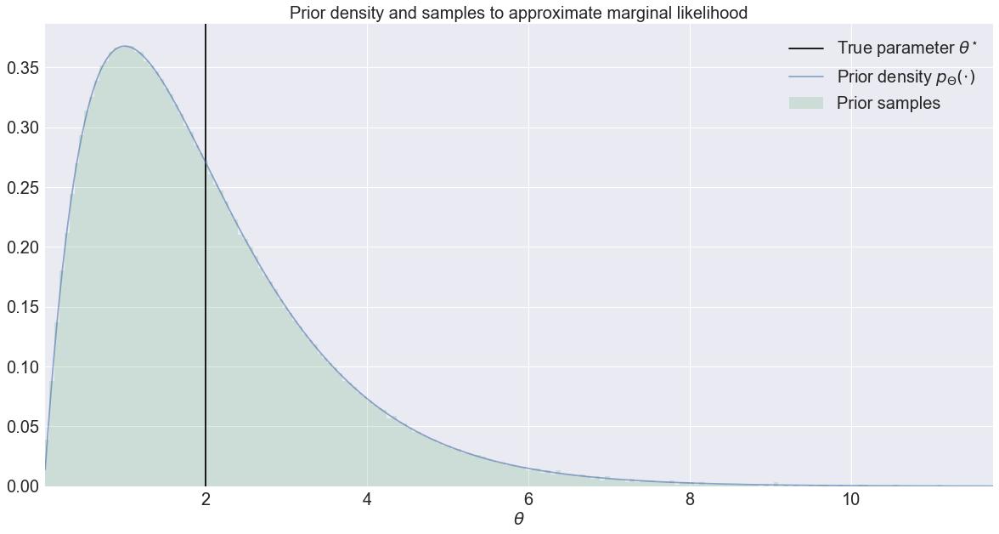

In [22]:
# Plot the prior density and samples
def temp_plot():
    
    # Setup
    sns.set()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((20, 10))
    
    # Computations
    t_min = prior_ppf(0.0001)
    t_max = prior_ppf(0.9999)
    t = np.linspace(t_min, t_max, 1000)
    
    # Plot
    plt.axvline(theta_true, c='k', label=r'True parameter $\theta^{\star}$')
    ax.plot(t, prior_pdf(t), alpha=0.6, label=r'Prior density $p_{\Theta}(\cdot)$')
    ax.hist(t_samples, bins=200, density=True, histtype='stepfilled', alpha=0.2, label='Prior samples')
    
    # Aesthetics
    ax.set_xlim((t_min, t_max))
    ax.set_title('Prior density and samples to approximate marginal likelihood', fontsize=20)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    ax.legend(fontsize=20)

temp_plot()

### Hyperparameter Learning by Optimizing the Marginal Kernel Means Likelihood (MKML): Grid Search

In this section we will find globally and locally optimal hyperparameters for KELFI. We will keep the regularization parameter fixed so that there are only two hyperparameters to optimize to enable visualization. The two hyperparameters are the length scale of each of the two Gaussian kernels, on the space of the parameters and summary statistics.

We will first just do a slow exhaustive grid search here since it is two-dimensions. This also enables us to visualize the objective function surface to gain a better understanding.

We will then find the optimal hyperparameters, including the regularization hyperparameter, by using gradient ascent.

In [23]:
use_saved_grid_search_results = False

In [24]:
def hyperparameter_learning_objective(beta, eps, reg=None):
    """Computes the approximate MKML for different hyperparameters."""
    weights = kernel_means_weights(y, x_sim, t_sim, eps, beta, reg=reg)
    return approximate_marginal_kernel_means_likelihood(t_samples, t_sim, weights, beta)

In [25]:
beta_array = np.linspace(0.5, 1.5, 100)
eps_array = np.linspace(0.1, 0.2, 100)
eps_grid, beta_grid = np.meshgrid(eps_array, beta_array)

In [26]:
if use_saved_grid_search_results:
    beta_global, eps_global = 0.803, 0.143
    mkml_global = hyperparameter_learning_objective(beta_global, eps_global)
else:
    mkml_grid = np.zeros((beta_array.shape[0], eps_array.shape[0]))
    mkml_global = -np.inf
    for i, beta in enumerate(beta_array):
        for j, eps in enumerate(eps_array):
            mkml_grid[i, j] = hyperparameter_learning_objective(beta, eps)
            if mkml_grid[i, j] > mkml_global:
                mkml_global = mkml_grid[i, j]
                beta_global = beta
                eps_global = eps
            print('(i, j) = (%d, %d)' % (i, j), '| (beta_global, eps_global) = (%.3f, %.3f)' % (beta_global, eps_global), '| Optimal Approximate MKML: %.3f' % mkml_global)
            clear_output(wait=True)
print('(beta_global, eps_global) = (%.3f, %.3f)' % (beta_global, eps_global), '| Globally Optimal Approximate MKML: %.3f' % mkml_global)

(beta_global, eps_global) = (0.803, 0.143) | Globally Optimal Approximate MKML: 0.825


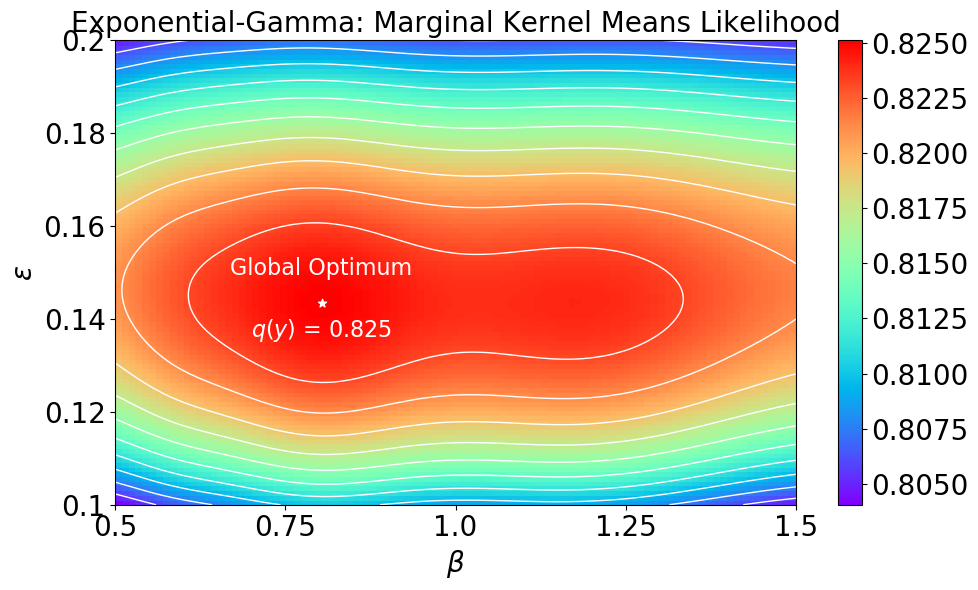

In [27]:
def temp_plot():
    
    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Plot
    plt.pcolormesh(beta_grid, eps_grid, mkml_grid, cmap='rainbow')
    cb = plt.colorbar()
    plt.contour(beta_grid, eps_grid, mkml_grid, linewidths=1, colors='w', levels=np.linspace(mkml_grid.min(), mkml_grid.max(), 12))
    plt.scatter(beta_global, eps_global, marker='*', c='w')
    plt.text(beta_global, eps_global + 0.005, r'Global Optimum', color='w', ha='center', va='bottom', fontsize=16)
    plt.text(beta_global, eps_global - 0.003, r'$q(y)$ = %.3f' % mkml_global, color='w', ha='center', va='top', fontsize=16)

    # Aesthetics
    plt.title('Exponential-Gamma: Marginal Kernel Means Likelihood', fontsize=20)
    plt.xlabel(r'$\beta$', fontsize=20)
    plt.ylabel(r'$\epsilon$', fontsize=20)
    plt.gca().set_xticks(np.arange(0.5, 1.75, 0.25))
    plt.gca().set_xticklabels(np.round(np.arange(0.5, 1.75, 0.25), 2), fontsize=20)
    plt.gca().set_yticks(np.arange(0.1, 0.22, 0.02))
    plt.gca().set_yticklabels(np.round(np.arange(0.1, 0.22, 0.02), 2), fontsize=20)
    cb.ax.tick_params(labelsize=20)
    plt.xlim((beta_grid.min(), beta_grid.max()))
    plt.ylim((eps_grid.min(), eps_grid.max()))
    plt.tight_layout()
    plt.show()

if not use_saved_grid_search_results:
    temp_plot()

In [28]:
# Find the local optima seen above
# Plot the negative log approximate marginal likelihood
if use_saved_grid_search_results:
    beta_local, eps_local = 1.167, 0.143
    mkml_local = hyperparameter_learning_objective(beta_local, eps_local)
else:
    mkml_local = -np.inf
    for i in range(int(0.5 * beta_array.shape[0]), int(1 * beta_array.shape[0])):
        for j in range(eps_array.shape[0]):
            if mkml_grid[i, j] > mkml_local:
                mkml_local = mkml_grid[i, j]
                beta_local = beta_array[i]
                eps_local = eps_array[j]
    print('(beta_local, eps_local) = (%.3f, %.3f)' % (beta_local, eps_local), '| Locally Optimal Approximate MKML: %.3f' % mkml_local)

(beta_local, eps_local) = (1.167, 0.143) | Locally Optimal Approximate MKML: 0.824


In [29]:
# Pick some arbitrary hyperparameters that is not optimal
beta_arb, eps_arb = 1., 0.185
mkml_arb = hyperparameter_learning_objective(beta_arb, eps_arb)

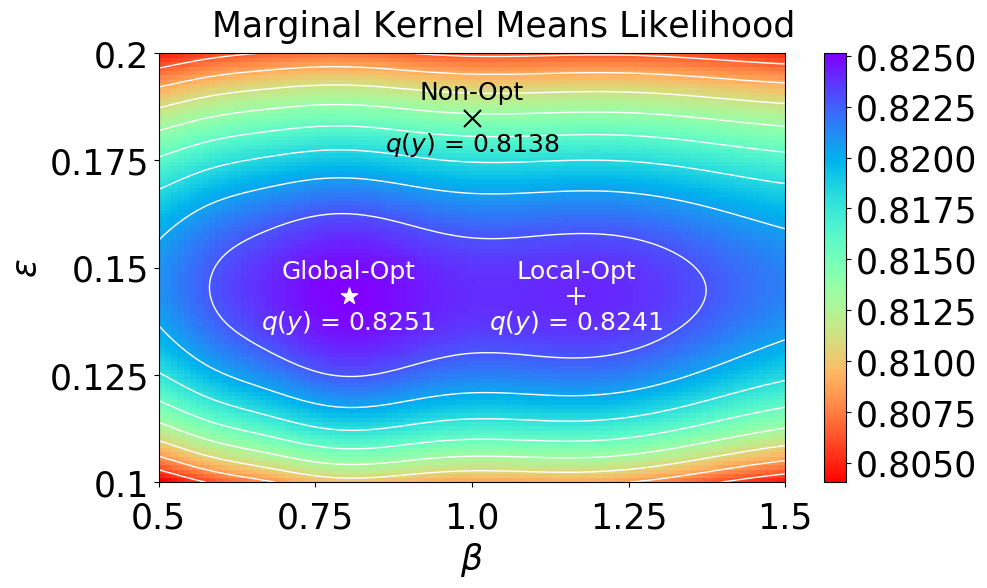

In [30]:
def temp_plot():
    
    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Plot
    plt.pcolormesh(beta_grid, eps_grid, mkml_grid, cmap='rainbow_r')
    cb = plt.colorbar()
    plt.contour(beta_grid, eps_grid, mkml_grid, linewidths=1, colors='w', levels=np.linspace(mkml_grid.min(), mkml_grid.max(), 10))
    
    plt.scatter(beta_global, eps_global, marker='*', c='w', s=150)
    plt.scatter(beta_local, eps_local, marker='+', c='w', s=150)
    plt.scatter(beta_arb, eps_arb, marker='x', c='k', zorder=10, s=150)
    
    plt.text(beta_global, eps_global + 0.003, r'Global-Opt', color='w', ha='center', va='bottom', fontsize=18)
    plt.text(beta_global, eps_global - 0.003, r'$q(y)$ = %.4f' % mkml_global, color='w', ha='center', va='top', fontsize=18)
    plt.text(beta_local, eps_local + 0.003, r'Local-Opt', color='w', ha='center', va='bottom', fontsize=18)
    plt.text(beta_local, eps_local - 0.003, r'$q(y)$ = %.4f' % mkml_local, color='w', ha='center', va='top', fontsize=18)
    plt.text(beta_arb, eps_arb + 0.003, r'Non-Opt', color='k', ha='center', va='bottom', fontsize=18, zorder=10)
    plt.text(beta_arb, eps_arb - 0.003, r'$q(y)$ = %.4f' % mkml_arb, color='k', ha='center', va='top', fontsize=18, zorder=10)

    # Aesthetics
    plt.title('Marginal Kernel Means Likelihood', fontsize=25, x=0.55, y=1.02)
    plt.xlabel(r'$\beta$', fontsize=25)
    plt.ylabel(r'$\epsilon$', fontsize=25)
    plt.gca().set_xticks(np.arange(0.5, 1.75, 0.25))
    plt.gca().set_xticklabels(np.round(np.arange(0.5, 1.75, 0.25), 2), fontsize=25, y=-0.02)
    plt.gca().set_yticks(np.arange(0.05, 0.225, 0.025))
    plt.gca().set_yticklabels(np.round(np.arange(0.05, 0.225, 0.025), 3), fontsize=25)
    cb.ax.tick_params(labelsize=25)
    plt.xlim((beta_grid.min(), beta_grid.max()))
    plt.ylim((eps_grid.min(), eps_grid.max()))
    plt.tight_layout()
    plt.show()

if not use_saved_grid_search_results:
    temp_plot()

Caption: The marginal kernel means likelihood surface used for hyperparameter learning. We show the global optimum, local optimum, and an arbitrary hyperparameter choice. We will later compare how their resulting approximate posteriors perform to demonstrate that higher MKML lead to better posterior approximations.

### Hyperparameter Learning by Optimizing the Marginal Kernel Means Likelihood (MKML): Gradient Descent with Automatic Differentiation

The hyperparameters are learned in log-space, and the minimization objective is the negative log marginal kernel means likelihood (NLMKML).

In [31]:
# Full hyperparameter learning with automatic differentiation
eps_tuple = (0.06, 'learn')
beta_tuple = (0.6, 'learn')
reg_tuple = (1e-6, 'learn')
eps_opt, beta_opt, reg_opt = kernel_means_hyperparameter_learning(
    y, x_sim, t_sim, eps_tuple, beta_tuple, reg_tuple,
    eps_ratios=1., beta_ratios=1., offset=0.,
    prior_samples=t_samples, prior_mean=None, prior_std=None,
    learning_rate=0.01, n_iter=5000, display_steps=100)
mkml_opt = hyperparameter_learning_objective(beta_opt, eps_opt, reg=reg_opt)
print('(beta_opt, eps_opt) = (%.3f, %.3f)' % (beta_opt, eps_opt), '| Optimal Approximate MKML: %.3f' % mkml_opt)

i:  0  | eps:  0.06  | beta:  0.6  | reg:  9.999998e-07  | ml:  0.70543116
i:  100  | eps:  0.077010795  | beta:  0.6752491  | reg:  9.977849e-07  | ml:  0.7829573
i:  200  | eps:  0.08932316  | beta:  0.67595863  | reg:  9.880224e-07  | ml:  0.8060582
i:  300  | eps:  0.09924517  | beta:  0.67530954  | reg:  9.815684e-07  | ml:  0.8038503
i:  400  | eps:  0.10786785  | beta:  0.67456007  | reg:  9.773827e-07  | ml:  0.8168873
i:  500  | eps:  0.11546603  | beta:  0.6712926  | reg:  9.732761e-07  | ml:  0.816352
i:  600  | eps:  0.12237195  | beta:  0.67484474  | reg:  9.693014e-07  | ml:  0.82181877
i:  700  | eps:  0.12827307  | beta:  0.6748531  | reg:  9.648552e-07  | ml:  0.8175806
i:  800  | eps:  0.13356574  | beta:  0.6750037  | reg:  9.624428e-07  | ml:  0.8212869
i:  900  | eps:  0.13798742  | beta:  0.6746986  | reg:  9.590243e-07  | ml:  0.8252222
i:  1000  | eps:  0.14160603  | beta:  0.67698747  | reg:  9.566876e-07  | ml:  0.8241256
i:  1100  | eps:  0.14444852  | beta: 

### Approximate Posteriors using Kernel Means Posterior (KMP)

In [32]:
def kmp_kmpe_mkml(t_query, beta, eps, reg=None, beta_query=None):
    """Computes the KMP, KMPE, and MKML under different hyperparameters"""
    weights = kernel_means_weights(y, x_sim, t_sim, eps, beta, reg=reg)
    mkml = approximate_marginal_kernel_means_likelihood(t_samples, t_sim, weights, beta)
    kmp = kernel_means_posterior(t_query, t_sim, weights, beta, prior_pdf, mkml)
    kmpe = approximate_kernel_means_posterior_embedding(t_query, t_sim, weights, beta, t_samples, marginal_likelihood=mkml, beta_query=beta_query)
    return kmp, kmpe, mkml

In [33]:
t_min = 0
t_max = 6
t_query = np.linspace(t_min, t_max, 1000)[:, np.newaxis]

In [34]:
# Pick a length scale for kernel herding
# This does not need to be the same as the beta that was learned for the KML, MKML, and KMP! 
# This represents the degree of precision you want to learn your posterior to
# Small length scales will require a lot of super-samples and takes longer
# Large legnth scales will only need a small number of super-samples but approximation will be more crude
beta_query = 0.2

In [35]:
# Compute the KMP, KMPE, and MKML
kmp_opt_query, kmpe_opt_query, mkml_opt = kmp_kmpe_mkml(t_query, beta_opt, eps_opt, reg=reg_opt, beta_query=beta_query)
kmp_global_query, kmpe_global_query, mkml_global = kmp_kmpe_mkml(t_query, beta_global, eps_global, reg=None, beta_query=beta_query)
kmp_local_query, kmpe_local_query, mkml_local = kmp_kmpe_mkml(t_query, beta_local, eps_local, reg=None, beta_query=beta_query)
kmp_arb_query, kmpe_arb_query, mkml_arb = kmp_kmpe_mkml(t_query, beta_arb, eps_arb, reg=None, beta_query=beta_query)

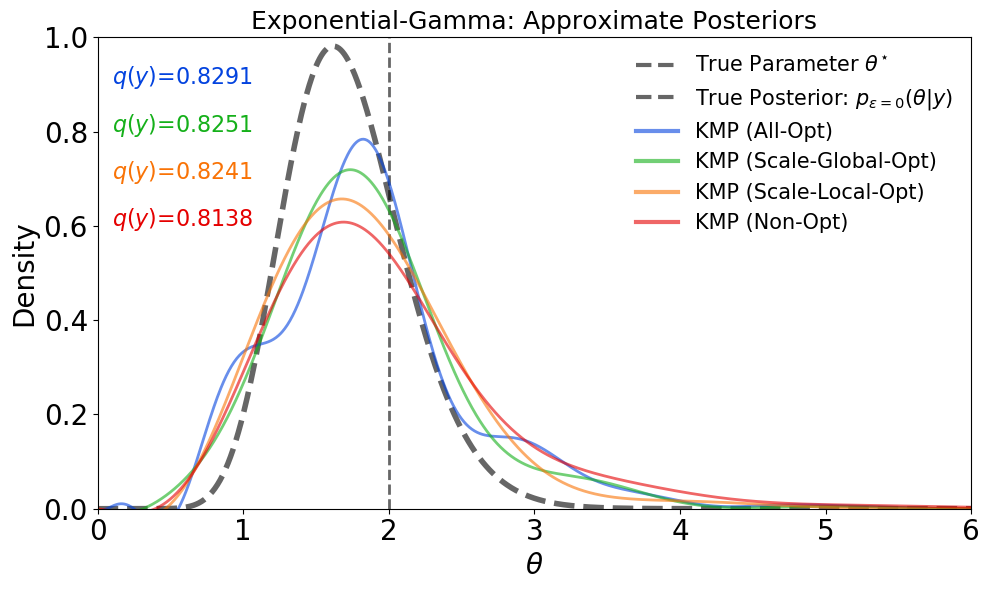

In [36]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ax.plot(t, kmp_opt_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (All-Opt)')
    ax.plot(t, kmp_global_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (Scale-Global-Opt)')
    ax.plot(t, kmp_local_query, c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (Scale-Local-Opt)')
    ax.plot(t, kmp_arb_query, c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KMP (Non-Opt)')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
 
    # Aesthetics
    ax.set_xlim((0, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    ax.set_ylabel(r'Density', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    
temp_plot()

Caption: Kernel Means Posteriors (KMP) for different hyperparameter choices. For All-Opt, all hyperparameters including regularization hyperparameters were optimized. For Scale-Opt, only length scale hyperparameters are optimized and regularization hyperparameters are kept fixed. The global and local optima are shown. For Non-Opt, arbitrary hyperparameters that are not optimized were chosen. Note that with 100 simulations it is very difficult to get an accurate posterior approximation. The value in the brackets show the corresponding MKML. This shows that higher MKML lead to more accurate KMPs. 

### Approximate Posteriors by Super-Sampling the Kernel Means Posterior Embedding

This is the full KELFI solution.

In [37]:
from kernels import gaussian_kernel_gramix, gaussian_density_gramix
from kernel_means_inference import kernel_herding


def kde(samples, query_points, ls, weights=None):
    """KDE for visualizing samples."""
    if weights is None:
        return gaussian_density_gramix(samples, query_points, ls).mean(axis=0)
    else:
        return np.dot(weights, gaussian_density_gramix(samples, query_points, ls))

In [38]:
def kelfi(beta, eps, reg=None, n_samples=1000, beta_query=None):
    """Full KELFI Solution."""
    weights = kernel_means_weights(y, x_sim, t_sim, eps, beta, reg=reg)
    mkml = approximate_marginal_kernel_means_likelihood(t_samples, t_sim, weights, beta)
    if beta_query is None:
        beta_query = beta
    kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, beta_query)
    kmpe_ = approximate_kernel_means_posterior_embedding(t_samples, t_sim, weights, beta, t_samples, marginal_likelihood=mkml, beta_query=beta_query)
    t_kmpe = kernel_herding(kmpe_, kernel_function, t_samples, n_samples)
    return t_kmpe

In [39]:
# Obtain posterior super-samples from the KMPE
n_samples = 10000
t_kmpe_opt = kelfi(beta_opt, eps_opt, reg=reg_opt, n_samples=n_samples, beta_query=beta_query)
t_kmpe_global = kelfi(beta_global, eps_global, reg=None, n_samples=n_samples, beta_query=beta_query)
t_kmpe_local = kelfi(beta_local, eps_local, reg=None, n_samples=n_samples, beta_query=beta_query)
t_kmpe_arb = kelfi(beta_arb, eps_arb, reg=None, n_samples=n_samples, beta_query=beta_query)

c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\ipykernel_launcher.py:53: RuntimeWarning: Mean of empty slice.
c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\numpy\core\_methods.py:73: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: Mean of empty slice.
Animation size has reached 21134136 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


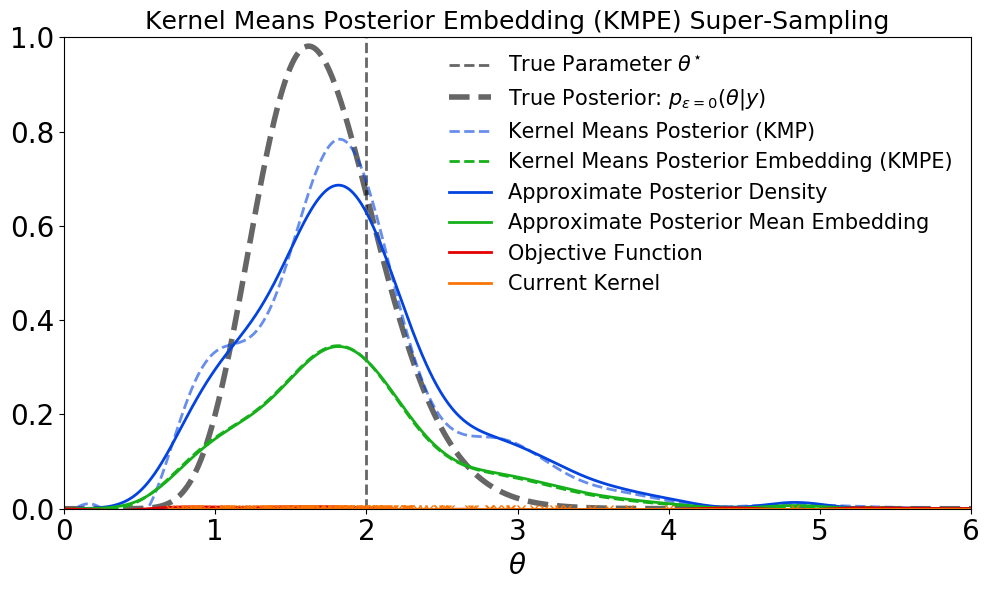

In [40]:
from IPython.display import HTML

# Here we visualize the kernel herding procedure for the optimal embedding
def animate_kernel_herding(t_query, density_query, mean_embedding_query, samples, beta_query=0.1, frames=None):
    
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))

    t = t_query.ravel()
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ax.plot(t, density_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='--', alpha=0.6, label=r'Kernel Means Posterior (KMP)')
    ax.plot(t, mean_embedding_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='--', label='Kernel Means Posterior Embedding (KMPE)')
    
    line_1, = ax.plot([], [], c=sns.xkcd_rgb['blue'], lw=2, label='Approximate Posterior Density')
    line_2, = ax.plot([], [], c=sns.xkcd_rgb['green'], lw=2, label='Approximate Posterior Mean Embedding')
    line_3, = ax.plot([], [], c=sns.xkcd_rgb['red'], lw=2, label='Objective Function')
    line_4, = ax.plot([], [], c=sns.xkcd_rgb['orange'], lw=2, label='Current Kernel')
    line_5, = ax.plot([], [], marker='x', c=sns.xkcd_rgb['orange'], lw=2)
    

    ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    ax.set_xlim((0, 6))
    ax.set_ylim((0, 1))
    ax.set_title('Kernel Means Posterior Embedding (KMPE) Super-Sampling', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()

    def init():
        line_1.set_data([], [])
        line_2.set_data([], [])
        line_3.set_data([], [])
        line_4.set_data([], [])
        line_5.set_data([], [])
        return line_1, line_2, line_3, line_4, line_5

    if frames is None:
        frames = samples.shape[0]
    mu = mean_embedding_query
    kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, beta_query)
    def animate(i):
        mu_hat_sum = kernel_function(samples[:i], t_query).sum(axis=0)
        mu_hat = mu_hat_sum / (i + 1)
        objective = mu - mu_hat
        
        line_1.set_data(t, gaussian_density_gramix(samples[:i], t_query, beta_query).mean(axis=0))
        line_2.set_data(t, kernel_function(samples[:i], t_query).mean(axis=0))
        line_3.set_data(t, objective)
        line_4.set_data(t, kernel_function(samples[[i]], t_query).ravel()) if i < frames - 1 else line_4.set_data(0, 0)
        line_5.set_data(samples[:i], 0)
        
        return line_1, line_2, line_3, line_4, line_5
    
    from matplotlib import animation, rc
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=frames, interval=frames, repeat_delay=1000,
                                   blit=True)
    return anim.to_jshtml()

HTML(animate_kernel_herding(t_query, kmp_opt_query, kmpe_opt_query, t_kmpe_opt, beta_query if beta_query is not None else beta_opt, frames=150))

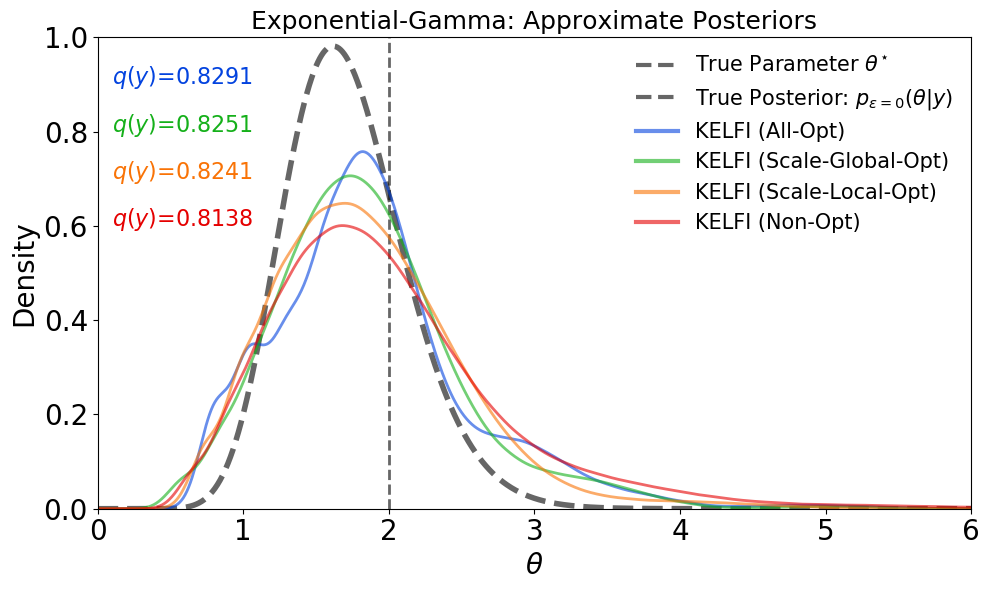

In [41]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ls = 0.1
    n_samples = 10000
    ax.plot(t, kde(t_kmpe_opt[:n_samples], t_query, ls), c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (All-Opt)')
    ax.plot(t, kde(t_kmpe_global[:n_samples], t_query, ls), c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (Scale-Global-Opt)')
    ax.plot(t, kde(t_kmpe_local[:n_samples], t_query, ls), c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (Scale-Local-Opt)')
    ax.plot(t, kde(t_kmpe_arb[:n_samples], t_query, ls), c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, label=r'KELFI (Non-Opt)')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
    
    # Aesthetics
    ax.set_xlim((t_min, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    ax.set_ylabel(r'Density', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    
temp_plot()

### Other Kernel-Based Likelihood-Free Inference Methods

Below we will compare to other kernel based likelihood-free inference approaches.

In [42]:
%%file gps_abc.py
"""
Gaussian process surrogate approximate Bayesian computation (GPS-ABC) [Meeds and Welling 2014]

Implementation is based on original paper

Not documented fully yet
"""
import numpy as np
from scipy import stats
from scipy import linalg as la


def rejection_abc_posterior_sampler(y, prior_sampler, likelihood_sampler, distance_function, eps,
                                    n_samples=10000, n_iter=10000, verbose=True):
    
    posterior_samples = []
    calls_history = []
    
    for i in range(n_iter):
        
        theta = prior_sampler()
        x = likelihood_sampler(theta)
        
        if distance_function(x, y) < eps:
            posterior_samples.append(theta)
            calls_history.append(likelihood_sampler.calls)
            if verbose:
                print('Accepted %d samples - currently used %d simulation calls' % (len(posterior_samples), likelihood_sampler.calls))
            
        if len(posterior_samples) >= n_samples:
            break
    
    return np.array(posterior_samples), np.array(calls_history)


def mnpdf(x, mean=None, cov=None):
    
    for jitter in np.linspace(0, np.max(cov), 1000):
        try:
            jitter_cov = cov + jitter * np.eye(cov.shape[0])
            return stats.multivariate_normal.pdf(x, mean=mean, cov=jitter_cov)
        except:
            print('\t\tNormal pdf requires jittering - so far jittered by %.2f' % jitter)
            
    
def sl_abc_mh_step(y, theta, prior_density, likelihood_sampler, n_sim, eps, proposal_std, return_x_sim=False):
    
    theta_proposal = theta + np.random.randn(theta.shape[0]) * proposal_std

    x_sim = []
    x_sim_proposal = []
    
    for s in range(n_sim):
        
        x_sim.append(likelihood_sampler(theta))
        x_sim_proposal.append(likelihood_sampler(theta_proposal))
        
    x_sim, x_sim_proposal = np.array(x_sim), np.array(x_sim_proposal)
    
    mu_sim = np.mean(x_sim, axis=0)
    sigma_sim = np.dot(np.transpose(x_sim - mu_sim), x_sim - mu_sim) / (n_sim - 1)
    mu_sim_proposal = np.mean(x_sim_proposal, axis=0)
    sigma_sim_proposal = np.dot(np.transpose(x_sim_proposal - mu_sim_proposal), x_sim_proposal - mu_sim_proposal) / (n_sim - 1)    
    
    # d = y.shape[0]
    # assert mu_sim.shape == (d,)
    # assert sigma_sim.shape == (d, d)
    
    prior_ratio = prior_density(theta_proposal) / prior_density(theta)
    likelihood_ratio = mnpdf(y, mean=mu_sim_proposal, cov=sigma_sim_proposal) / mnpdf(y, mean=mu_sim, cov=sigma_sim)
    
    alpha = prior_ratio * likelihood_ratio

    if return_x_sim:
        return (theta_proposal, x_sim_proposal) if np.random.rand() < alpha else (theta, x_sim)
    else:
        return theta_proposal if np.random.rand() < alpha else theta
    

def sl_abc_posterior_sampler(y, prior_density, prior_sampler, likelihood_sampler, n_sim, eps, proposal_std, 
                             eps_init=None, n_samples=10000, verbose=True, return_x_sim=False):
    
    distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
    theta = rejection_abc_posterior_sampler(y, prior_sampler, likelihood_sampler, 
                                            distance_function, eps_init,
                                            n_samples=1, n_iter=n_samples, verbose=False)[0][0]
    
    posterior_samples = []
    calls_history = []
    if return_x_sim:
        x_sim_list = []
    
    for i in range(n_samples):
        
        if return_x_sim:
            theta, x_sim = sl_abc_mh_step(y, theta, prior_density, likelihood_sampler, n_sim, eps, proposal_std, return_x_sim=True)
            x_sim_list.append(x_sim)
        else:
            theta = sl_abc_mh_step(y, theta, prior_density, likelihood_sampler, n_sim, eps, proposal_std, return_x_sim=False)
        posterior_samples.append(theta)
        calls_history.append(likelihood_sampler.calls)
        print('Proposal for sample %d %s - currently used %d simulation calls ' % (i, 'rejected' if np.allclose(theta, posterior_samples[i - 1]) else 'accepted', likelihood_sampler.calls)) if verbose and i > 0 else None
        
    if return_x_sim:
        return np.array(posterior_samples), np.array(x_sim_list), np.array(calls_history)
    else:
        return np.array(posterior_samples), np.array(calls_history)


def asl_abc_mh_step(y, theta, prior_density, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std):
    
    theta_proposal = theta + np.random.randn(theta.shape[0]) * proposal_std

    c = 0
    S = s_0
    
    reg = eps ** 2 * np.eye(y.shape[-1])

    x_sim = []
    x_sim_proposal = []
    
    while True:
        
        for s in range(c, c + S):
            
            x_sim.append(likelihood_sampler(theta))
            x_sim_proposal.append(likelihood_sampler(theta_proposal))            

        c = S
        S += ds
        
        n_samples = len(x_sim)
        x_sim_, x_sim_proposal_ = np.array(x_sim), np.array(x_sim_proposal)

        mu_sim = np.mean(x_sim_, axis=0)
        sigma_sim = np.dot(np.transpose(x_sim_ - mu_sim), x_sim_ - mu_sim) / (n_samples - 1)
        mu_sim_proposal = np.mean(x_sim_proposal_, axis=0)
        sigma_sim_proposal = np.dot(np.transpose(x_sim_proposal_ - mu_sim_proposal), x_sim_proposal_ - mu_sim_proposal) / (n_samples - 1)    
        
        alpha = np.zeros(m)
        
        for i in range(m):
            
            mu_sim_sample = stats.multivariate_normal.rvs(mean=mu_sim, cov=sigma_sim/n_samples)
            mu_sim_proposal_sample = stats.multivariate_normal.rvs(mean=mu_sim_proposal, cov=sigma_sim_proposal/n_samples)
            
            prior_ratio = prior_density(theta_proposal) / prior_density(theta)
            likelihood_ratio = mnpdf(y, mean=mu_sim_proposal_sample, cov=sigma_sim_proposal+reg) / mnpdf(y, mean=mu_sim_sample, cov=sigma_sim+reg)

            alpha[i] = prior_ratio * likelihood_ratio
            
        tau = np.median(alpha)
        
        n_unif_samples = m  # Does not have to be m
        u_samples = np.random.rand(n_unif_samples)
        error = np.mean([np.mean(alpha < u) if u <= tau else np.mean(alpha >= u) for u in u_samples])
        
        if error < error_tol:
            break
        print('\tError is still %.3f when using %d samples - continue to next iteration' % (error, n_samples))
            
    return theta_proposal if np.random.rand() < tau else theta
        

def asl_abc_posterior_sampler(y, prior_density, prior_sampler, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std,
                              eps_init=None, n_samples=10000, verbose=True):
    
    distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
    theta = rejection_abc_posterior_sampler(y, prior_sampler, likelihood_sampler, 
                                            distance_function, eps_init,
                                            n_samples=1, n_iter=n_samples, verbose=verbose)[0][0]
    
    posterior_samples = []
    calls_history = []
    
    for i in range(n_samples):
        
        theta = asl_abc_mh_step(y, theta, prior_density, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std)
        posterior_samples.append(theta)
        calls_history.append(likelihood_sampler.calls)
        print('Proposal for sample %d %s - currently used %d simulation calls ' % (i, 'rejected' if np.allclose(theta, posterior_samples[i - 1]) else 'accepted', likelihood_sampler.calls)) if verbose and i > 0 else None
        
    return np.array(posterior_samples), np.array(calls_history)


def gps_abc_mh_step(y, theta, prior_density, s_0, ds, m, eps, error_tol, proposal_std, gp_predict, verbose=True):
    
    theta_proposal = theta + np.random.randn(theta.shape[0]) * proposal_std
    
    d = y.shape[-1]
    
    # The original paper does not use covariance so we will not use it here, although it can be done
    gp_mu, gp_std = gp_predict(np.array([theta, theta_proposal]))
            
    while True:
        
        alpha = np.zeros(m)
        
        for i in range(m):
            
            mu_sim_sample = np.random.randn(d) * gp_std[0, :] + gp_mu[0, :]
            mu_sim_proposal_sample = np.random.randn(d) * gp_std[1, :] + gp_mu[1, :]
            
            prior_ratio = prior_density(theta_proposal) / prior_density(theta)
            likelihood_ratio_top = stats.norm.pdf(y, loc=mu_sim_proposal_sample, scale=np.sqrt(gp_std[1, :]**2 + eps**2))
            likelihood_ratio_bot = stats.norm.pdf(y, loc=mu_sim_sample, scale=np.sqrt(gp_std[0, :]**2 + eps**2))
            likelihood_ratio = np.prod(likelihood_ratio_top / likelihood_ratio_bot)
            alpha[i] = prior_ratio * likelihood_ratio
            
        tau = np.median(alpha)
        
        n_unif_samples = m  # Does not have to be m
        u_samples = np.random.rand(n_unif_samples)
        error = np.mean([np.mean(alpha < u) if u <= tau else np.mean(alpha >= u) for u in u_samples])
        
        if error < error_tol:
            break
        else:
            acq = True
            return (theta_proposal, acq)
        
    acq = False
    return (theta_proposal, acq) if np.random.rand() < tau else (theta, acq)


def gps_abc_sampler(y, prior_density, prior_sampler, likelihood_sampler, s_0, ds, m, eps, error_tol, proposal_std,
                    eps_init=None, n_samples=10000, n_iter=100000, verbose=True):

    from sklearn.gaussian_process import GaussianProcessRegressor
    
    theta_samples, x_samples, _ = sl_abc_posterior_sampler(y, prior_density, prior_sampler, likelihood_sampler, 
                                                           ds, eps, proposal_std, eps_init=eps_init, n_samples=s_0, return_x_sim=True)
    # The GPS-ABC algorithm is only designed to take one x at one theta
    x_samples = x_samples[:, 0, :]
    
    posterior_samples = theta_samples.copy()
    calls_history = []
    
    
    gps = [GaussianProcessRegressor().fit(theta_samples, x_samples[:, j]) for j in range(y.shape[-1])]
    
    # Start off with the best theta (this wasn't mentioned in the paper but we will do this to make GPS start off well)
    theta = theta_samples[np.argmax(np.sum((x_samples - y) ** 2, axis=-1))]
    
    print('Initialized GPS - starting GPS-ABC...') if verbose else None
    
    for i in range(n_iter):

        def gp_predict(theta_query):

            mu = np.zeros((theta_query.shape[0], y.shape[0]))
            std = np.zeros((theta_query.shape[0], y.shape[0]))
            
            for j in range(y.shape[0]):
                mu[:, j], std[:, j] = gps[j].predict(theta_query, return_std=True)
                
            # (n_query, d)
            return mu, std
            
        theta_proposal, acq = gps_abc_mh_step(y, theta, prior_density, s_0, ds, m, eps, error_tol, proposal_std, gp_predict, verbose=verbose)
        theta = theta_proposal  # This is already rejected or accepted in the step
        
        # Remember posterior samples does not have to be the same as the samples used to train the GP
        if acq:
            x_proposal = likelihood_sampler(theta_proposal)
            theta_samples = np.concatenate((theta_samples, np.array([theta_proposal])), axis=0)
            x_samples = np.concatenate((x_samples, np.array([x_proposal])), axis=0)
            gps = [GaussianProcessRegressor().fit(theta_samples, x_samples[:, j]) for j in range(y.shape[0])]
            print('Step %d: Acquiring a new point for %d total points to train the Gaussian process' % (i, theta_samples.shape[0])) if verbose else None
            
        else:
            
            posterior_samples = np.concatenate((posterior_samples, np.array([theta_proposal])), axis=0)
            calls_history.append(likelihood_sampler.calls)
            print('Step %d: Accepting current sample' % i) if verbose else None
            
        if len(posterior_samples) >= n_samples:
            break
            
            
    return posterior_samples, np.array(calls_history)

Overwriting gps_abc.py


In [43]:
%%file kme_abc.py
"""
Other approximate Bayesian computation methods using the kernel mean embedding framework.

- K-ABC (K1-ABC) [Nakagome et. al. 2013]
- K2-ABC [Park et. al. 2016]
- KBR (KBR-ABC) [Fukumizu et. al. 2013, Song et. al. 2013] (There are two versions provided by Song et. al. (2013))

Implementation is based on original papers

Not documented fully yet
"""
import numpy as np
from kernels import gaussian_kernel_gramix
from scipy import linalg as la


def k1_abc_weights(y, x_sim, theta_sim, gamma, reg):
    
    m, d = x_sim.shape

    k = gaussian_kernel_gramix(x_sim, x_sim, gamma)
    k_y = gaussian_kernel_gramix(x_sim, y, gamma)
    
    lower = True
    chol = la.cholesky(k + m * reg * np.eye(m), lower=lower)
    weights = la.cho_solve((chol, lower), k_y)
    
    return weights.ravel()

    
def k2_abc_weights(y_data, x_data_sim, theta_sim, eps):
    
    m, n = x_data_sim.shape
    
    weights = np.zeros(m)
    
    gamma = np.median(np.abs(y_data[:, np.newaxis] - y_data[np.newaxis, :]))
    
    y_data_ = y_data[:, np.newaxis]
    
    for j in range(m):
        x_data_ = x_data_sim[j][:, np.newaxis]
        
        k_xx = gaussian_kernel_gramix(x_data_, x_data_, gamma)
        k_yy = gaussian_kernel_gramix(y_data_, y_data_, gamma)
        k_xy = gaussian_kernel_gramix(x_data_, y_data_, gamma)
        
        m_xx = (np.sum(k_xx) - np.sum(k_xx.diagonal())) / (k_xx.shape[0] * (k_xx.shape[0] - 1))
        m_yy = (np.sum(k_yy) - np.sum(k_yy.diagonal())) / (k_yy.shape[0] * (k_yy.shape[0] - 1))
        m_xy = np.mean(k_xy)
        mmdsq = m_xx - 2 * m_xy + m_yy
        weights[j] = np.exp(- mmdsq / eps)
        
    return weights.ravel() / weights.sum()


def kbr_1_abc_weights(y, x_sim, t_sim, t_prior, ls_x, ls_t, reg_x, reg_t):
    
    m, d = x_sim.shape

    n_prior = t_prior.shape[0]
    
    k = gaussian_kernel_gramix(x_sim, x_sim, ls_x)
    k_y = gaussian_kernel_gramix(x_sim, y, ls_x)
    
    l = gaussian_kernel_gramix(t_sim, t_sim, ls_t)
    l_prior = gaussian_kernel_gramix(t_sim, t_prior, ls_t)
    
    w_prior = np.ones(n_prior) / n_prior
    
    lower = True
    chol = la.cholesky(l + m * reg_t * np.eye(m), lower=lower)
    diag = np.diag(la.cho_solve((chol, lower), np.dot(l_prior, w_prior)))
    lamb = la.cho_solve((chol, lower), np.dot(l_prior, np.diag(w_prior)))
    
    dk = np.dot(diag, k)
    dk2 = np.dot(dk, dk)
    
    lower = True
    chol = la.cholesky(dk2 + m * reg_x * np.eye(m), lower=lower)
    weights = np.dot(lamb.transpose(), la.cho_solve((chol, lower), np.dot(np.dot(k, diag), k_y)))
    
    return weights.ravel()


def kbr_2_abc_weights(y, x_sim, t_sim, t_prior, ls_x, ls_t, reg_x, reg_t):
    
    m, d = x_sim.shape

    n_prior = t_prior.shape[0]
    
    k = gaussian_kernel_gramix(x_sim, x_sim, ls_x)
    k_y = gaussian_kernel_gramix(x_sim, y, ls_x)
    
    l = gaussian_kernel_gramix(t_sim, t_sim, ls_t)
    l_prior = gaussian_kernel_gramix(t_sim, t_prior, ls_t)
    
    w_prior = np.ones(n_prior) / n_prior
    
    lower = True
    chol = la.cholesky(l + m * reg_t * np.eye(m), lower=lower)
    diag = np.diag(la.cho_solve((chol, lower), np.dot(l_prior, w_prior)))
    
    dk = np.dot(diag, k)
    dk2 = np.dot(dk, dk)
    
    lower = True
    chol = la.cholesky(dk2 + m * reg_x * np.eye(m), lower=lower)
    weights = np.dot(dk, la.cho_solve((chol, lower), np.dot(diag, k_y)))
    
    return weights.ravel()

Overwriting kme_abc.py


In [44]:
# This is for visualizing the kernel herding procedure for other kernel mean embeddings approaches that produce posterior mean embeddings directly
def animate_kernel_herding(t_query, density_query, mean_embedding_query, samples, ls_sample=0.1, ls_vis=0.1, frames=None):
    
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))

    t = t_query.ravel()
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    ax.plot(t, density_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='--', alpha=0.6, label=r'Posterior Surrogate Density')
    ax.plot(t, mean_embedding_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='--', label='Posterior Mean Embedding')
    
    line_1, = ax.plot([], [], c=sns.xkcd_rgb['blue'], lw=2, label='Approximate Posterior Density')
    line_2, = ax.plot([], [], c=sns.xkcd_rgb['green'], lw=2, label='Approximate Posterior Mean Embedding')
    line_3, = ax.plot([], [], c=sns.xkcd_rgb['red'], lw=2, label='Objective Function')
    line_4, = ax.plot([], [], c=sns.xkcd_rgb['orange'], lw=2, label='Current Kernel')
    line_5, = ax.plot([], [], marker='x', c=sns.xkcd_rgb['orange'], lw=2)
    

    ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    ax.set_xlim((0, 6))
    ax.set_ylim((0, 1))
    ax.set_title('Posterior Mean Embedding Super-Sampling', fontsize=18)
    ax.set_xlabel(r'$\theta$', fontsize=20)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(20) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    plt.tight_layout()

    def init():
        line_1.set_data([], [])
        line_2.set_data([], [])
        line_3.set_data([], [])
        line_4.set_data([], [])
        line_5.set_data([], [])
        return line_1, line_2, line_3, line_4, line_5

    if frames is None:
        frames = samples.shape[0]
    mu = mean_embedding_query
    kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_sample)
    def animate(i):
        mu_hat_sum = kernel_function(samples[:i], t_query).sum(axis=0)
        mu_hat = mu_hat_sum / (i + 1)
        objective = mu - mu_hat
        
        line_1.set_data(t, gaussian_density_gramix(samples[:i], t_query, ls_vis).mean(axis=0))
        line_2.set_data(t, kernel_function(samples[:i], t_query).mean(axis=0))
        line_3.set_data(t, objective)
        line_4.set_data(t, kernel_function(samples[[i]], t_query).ravel()) if i < frames - 1 else line_4.set_data(0, 0)
        line_5.set_data(samples[:i], 0)
        
        return line_1, line_2, line_3, line_4, line_5
    
    from matplotlib import animation, rc
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=frames, interval=frames, repeat_delay=1000,
                                   blit=True)
    return anim.to_jshtml()

In [45]:
# Median Length Heuristic in the Parameter Space
ls_mlh = np.median(np.abs(t_samples[:, np.newaxis] - t_samples[np.newaxis, :]))  # Median length heuristic

In [46]:
# Set this to true to also see super-sampling on K-ABC, K2-ABC, and KBR
animate = False

### Kernel-ABC (K-ABC)

In [47]:
from kme_abc import k1_abc_weights

In [48]:
# Hyperparameters
ls_t = ls_mlh  # Median length heuristic
ls_t_vis = ls_mlh / 3  # For sample visualizations
gamma = np.median(np.abs(s_x[:, np.newaxis] - s_x[np.newaxis, :]))  # Median length heuristic
reg = 1e-1

In [49]:
# Weights
weights = k1_abc_weights(s_y, s_x, t_sim, gamma, reg)
weights.sum()
weights = weights / weights.sum()
k1_abc_sample_weights = weights.copy()

0.9194192749884321

In [50]:
# Density and Embedding
k1_abc_posterior_density_query = kde(t_sim, t_query, ls_t_vis, weights)
k1_abc_posterior_mean_embedding_query = np.dot(weights, gaussian_kernel_gramix(t_sim, t_query, ls_t))

In [51]:
# Super-Samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_t)
mean_embedding_values = np.dot(weights, gaussian_kernel_gramix(t_sim, t_samples, ls_t))
k1_abc_posterior_samples = kernel_herding(mean_embedding_values, kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [52]:
# Animation
HTML(animate_kernel_herding(t_query, k1_abc_posterior_density_query, k1_abc_posterior_mean_embedding_query, 
                            k1_abc_posterior_samples, ls_sample=ls_t, ls_vis=ls_t_vis, frames=150)) if animate else None

### Double Kernel-ABC (K2-ABC)

In [53]:
from kme_abc import k2_abc_weights

In [54]:
# Hyperparameters
ls_t = ls_mlh  # Median length heuristic
ls_t_vis = ls_mlh / 3  # For sample visualizations
eps = np.median(np.abs(x_data_sim[:, np.newaxis] - x_data_sim[np.newaxis, :]))  # Median length heuristic

In [55]:
# Weights
weights = k2_abc_weights(y_data[0, :, 0], x_data_sim[:, :, 0], t_sim, eps)
weights.sum()
k2_abc_sample_weights = weights.copy()

1.0

In [56]:
# Density and Embedding
k2_abc_posterior_density_query = kde(t_sim, t_query, ls_t_vis, weights)
k2_abc_posterior_mean_embedding_query = np.dot(weights, gaussian_kernel_gramix(t_sim, t_query, ls_t))

In [57]:
# Super-Samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_t)
mean_embedding_values = np.dot(weights, gaussian_kernel_gramix(t_sim, t_samples, ls_t))
k2_abc_posterior_samples = kernel_herding(mean_embedding_values, kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [58]:
# Animation
HTML(animate_kernel_herding(t_query, k2_abc_posterior_density_query, k2_abc_posterior_mean_embedding_query, 
                            k2_abc_posterior_samples, ls_sample=ls_t, ls_vis=ls_t_vis, frames=150)) if animate else None

### KBR-ABC

In this case KBR-1 and KBR-2 give identical results, so we will just show KBR-1

In [59]:
from kme_abc import kbr_1_abc_weights

In [60]:
# Hyperparameters
ls_t = ls_mlh  # Median length heuristic
ls_t_vis = ls_mlh / 3  # For sample visualizations
ls_x = np.median(np.abs(s_x[:, np.newaxis] - s_x[np.newaxis, :]))  # Median length heuristic
reg_x = 1e-1
reg_t = 1e-1

In [61]:
# Sample weights
weights = kbr_1_abc_weights(s_y, s_x, t_sim, t_samples, ls_x, ls_t, reg_x, reg_t)
weights.sum()
weights = weights / weights.sum()
kbr_1_abc_sample_weights = weights.copy()

0.028861785626846707

In [62]:
# Density and Embedding
kbr_1_abc_posterior_density_query = kde(t_samples, t_query, ls_t_vis, weights)
kbr_1_abc_posterior_mean_embedding_query = np.dot(weights, gaussian_kernel_gramix(t_samples, t_query, ls_t))

In [63]:
# Super-Samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, ls_t)
mean_embedding_values = np.dot(weights, gaussian_kernel_gramix(t_samples, t_samples, ls_t))
kbr_1_abc_samples = kernel_herding(mean_embedding_values.ravel(), kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [64]:
# Animation
HTML(animate_kernel_herding(t_query, kbr_1_abc_posterior_density_query, kbr_1_abc_posterior_mean_embedding_query, 
                            kbr_1_abc_samples, ls_sample=ls_t, ls_vis=ls_t_vis, frames=150)) if animate else None

### GPS-ABC-1

We try to follow the settings from the original paper. If the paper does not mention the settings, then we hand-tune it by trial and error. Here is one of those settings.

In [65]:
from gps_abc import gps_abc_sampler

In [66]:
# Hyperparameters
distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
proposal_std = 0.5
s_0 = 20
ds = 2
m_ = 10
eps = 1
error_tol = 0.01
n_samples = 10000

In [67]:
# Problem Setup
prior_density = prior_pdf
prior_sampler = lambda: np.array([stats.gamma.ppf(np.random.rand(), alpha_true, scale=1/beta_true)])
def likelihood_sampler(theta):
    likelihood_sampler.calls += 1
    return summary_statistics(likelihood_simulator(theta))
likelihood_sampler.calls = 0

In [68]:
# Run Algorithm
np.random.seed(0)
posterior_samples, calls_history = gps_abc_sampler(s_y.ravel(), prior_density, prior_sampler, likelihood_sampler,
                                                   s_0, ds, m_, eps, error_tol, proposal_std,
                                                   eps_init=5, n_samples=n_samples, n_iter=n_samples*100, verbose=True)
calls_final = likelihood_sampler.calls
calls_final

Proposal for sample 1 rejected - currently used 9 simulation calls 
Proposal for sample 2 rejected - currently used 13 simulation calls 
Proposal for sample 3 accepted - currently used 17 simulation calls 
Proposal for sample 4 rejected - currently used 21 simulation calls 
Proposal for sample 5 accepted - currently used 25 simulation calls 
Proposal for sample 6 accepted - currently used 29 simulation calls 
Proposal for sample 7 rejected - currently used 33 simulation calls 
Proposal for sample 8 accepted - currently used 37 simulation calls 
Proposal for sample 9 rejected - currently used 41 simulation calls 
Proposal for sample 10 rejected - currently used 45 simulation calls 
Proposal for sample 11 accepted - currently used 49 simulation calls 
Proposal for sample 12 rejected - currently used 53 simulation calls 
Proposal for sample 13 accepted - currently used 57 simulation calls 
Proposal for sample 14 rejected - currently used 61 simulation calls 
Proposal for sample 15 rejecte

c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\sklearn\gaussian_process\gpr.py:335: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn("Predicted variances smaller than 0. "


Step 29: Accepting current sample
Step 30: Accepting current sample
Step 31: Accepting current sample
Step 32: Accepting current sample
Step 33: Accepting current sample
Step 34: Accepting current sample
Step 35: Accepting current sample
Step 36: Accepting current sample
Step 37: Accepting current sample
Step 38: Accepting current sample
Step 39: Accepting current sample
Step 40: Accepting current sample
Step 41: Accepting current sample
Step 42: Accepting current sample
Step 43: Accepting current sample
Step 44: Accepting current sample
Step 45: Accepting current sample
Step 46: Accepting current sample
Step 47: Accepting current sample
Step 48: Accepting current sample
Step 49: Accepting current sample
Step 50: Accepting current sample
Step 51: Accepting current sample
Step 52: Accepting current sample
Step 53: Accepting current sample
Step 54: Accepting current sample
Step 55: Accepting current sample
Step 56: Accepting current sample
Step 57: Accepting current sample
Step 58: Accep

Step 275: Accepting current sample
Step 276: Accepting current sample
Step 277: Accepting current sample
Step 278: Accepting current sample
Step 279: Accepting current sample
Step 280: Accepting current sample
Step 281: Accepting current sample
Step 282: Accepting current sample
Step 283: Accepting current sample
Step 284: Accepting current sample
Step 285: Accepting current sample
Step 286: Accepting current sample
Step 287: Accepting current sample
Step 288: Accepting current sample
Step 289: Accepting current sample
Step 290: Accepting current sample
Step 291: Accepting current sample
Step 292: Accepting current sample
Step 293: Accepting current sample
Step 294: Accepting current sample
Step 295: Accepting current sample
Step 296: Accepting current sample
Step 297: Accepting current sample
Step 298: Accepting current sample
Step 299: Accepting current sample
Step 300: Accepting current sample
Step 301: Accepting current sample
Step 302: Accepting current sample
Step 303: Accepting 

Step 524: Accepting current sample
Step 525: Accepting current sample
Step 526: Accepting current sample
Step 527: Accepting current sample
Step 528: Accepting current sample
Step 529: Accepting current sample
Step 530: Accepting current sample
Step 531: Accepting current sample
Step 532: Accepting current sample
Step 533: Accepting current sample
Step 534: Accepting current sample
Step 535: Accepting current sample
Step 536: Accepting current sample
Step 537: Accepting current sample
Step 538: Accepting current sample
Step 539: Accepting current sample
Step 540: Accepting current sample
Step 541: Accepting current sample
Step 542: Accepting current sample
Step 543: Accepting current sample
Step 544: Accepting current sample
Step 545: Accepting current sample
Step 546: Accepting current sample
Step 547: Accepting current sample
Step 548: Accepting current sample
Step 549: Accepting current sample
Step 550: Accepting current sample
Step 551: Accepting current sample
Step 552: Accepting 

Step 783: Accepting current sample
Step 784: Accepting current sample
Step 785: Accepting current sample
Step 786: Accepting current sample
Step 787: Accepting current sample
Step 788: Accepting current sample
Step 789: Accepting current sample
Step 790: Accepting current sample
Step 791: Accepting current sample
Step 792: Accepting current sample
Step 793: Accepting current sample
Step 794: Accepting current sample
Step 795: Accepting current sample
Step 796: Accepting current sample
Step 797: Accepting current sample
Step 798: Accepting current sample
Step 799: Accepting current sample
Step 800: Accepting current sample
Step 801: Accepting current sample
Step 802: Accepting current sample
Step 803: Accepting current sample
Step 804: Accepting current sample
Step 805: Accepting current sample
Step 806: Accepting current sample
Step 807: Accepting current sample
Step 808: Accepting current sample
Step 809: Accepting current sample
Step 810: Accepting current sample
Step 811: Accepting 

Step 1024: Accepting current sample
Step 1025: Accepting current sample
Step 1026: Accepting current sample
Step 1027: Accepting current sample
Step 1028: Accepting current sample
Step 1029: Accepting current sample
Step 1030: Accepting current sample
Step 1031: Accepting current sample
Step 1032: Accepting current sample
Step 1033: Accepting current sample
Step 1034: Accepting current sample
Step 1035: Accepting current sample
Step 1036: Accepting current sample
Step 1037: Accepting current sample
Step 1038: Accepting current sample
Step 1039: Accepting current sample
Step 1040: Accepting current sample
Step 1041: Accepting current sample
Step 1042: Accepting current sample
Step 1043: Accepting current sample
Step 1044: Accepting current sample
Step 1045: Accepting current sample
Step 1046: Accepting current sample
Step 1047: Accepting current sample
Step 1048: Accepting current sample
Step 1049: Accepting current sample
Step 1050: Accepting current sample
Step 1051: Accepting current

Step 1278: Accepting current sample
Step 1279: Accepting current sample
Step 1280: Accepting current sample
Step 1281: Accepting current sample
Step 1282: Accepting current sample
Step 1283: Accepting current sample
Step 1284: Accepting current sample
Step 1285: Accepting current sample
Step 1286: Accepting current sample
Step 1287: Accepting current sample
Step 1288: Accepting current sample
Step 1289: Accepting current sample
Step 1290: Accepting current sample
Step 1291: Accepting current sample
Step 1292: Accepting current sample
Step 1293: Accepting current sample
Step 1294: Accepting current sample
Step 1295: Accepting current sample
Step 1296: Accepting current sample
Step 1297: Accepting current sample
Step 1298: Accepting current sample
Step 1299: Accepting current sample
Step 1300: Accepting current sample
Step 1301: Accepting current sample
Step 1302: Accepting current sample
Step 1303: Accepting current sample
Step 1304: Accepting current sample
Step 1305: Accepting current

Step 1534: Accepting current sample
Step 1535: Accepting current sample
Step 1536: Accepting current sample
Step 1537: Accepting current sample
Step 1538: Accepting current sample
Step 1539: Accepting current sample
Step 1540: Accepting current sample
Step 1541: Accepting current sample
Step 1542: Accepting current sample
Step 1543: Accepting current sample
Step 1544: Accepting current sample
Step 1545: Accepting current sample
Step 1546: Accepting current sample
Step 1547: Accepting current sample
Step 1548: Accepting current sample
Step 1549: Accepting current sample
Step 1550: Accepting current sample
Step 1551: Accepting current sample
Step 1552: Accepting current sample
Step 1553: Accepting current sample
Step 1554: Accepting current sample
Step 1555: Accepting current sample
Step 1556: Accepting current sample
Step 1557: Accepting current sample
Step 1558: Accepting current sample
Step 1559: Accepting current sample
Step 1560: Accepting current sample
Step 1561: Accepting current

Step 1785: Accepting current sample
Step 1786: Accepting current sample
Step 1787: Accepting current sample
Step 1788: Accepting current sample
Step 1789: Accepting current sample
Step 1790: Accepting current sample
Step 1791: Accepting current sample
Step 1792: Accepting current sample
Step 1793: Accepting current sample
Step 1794: Accepting current sample
Step 1795: Accepting current sample
Step 1796: Accepting current sample
Step 1797: Accepting current sample
Step 1798: Accepting current sample
Step 1799: Accepting current sample
Step 1800: Accepting current sample
Step 1801: Accepting current sample
Step 1802: Accepting current sample
Step 1803: Accepting current sample
Step 1804: Accepting current sample
Step 1805: Accepting current sample
Step 1806: Accepting current sample
Step 1807: Accepting current sample
Step 1808: Accepting current sample
Step 1809: Accepting current sample
Step 1810: Accepting current sample
Step 1811: Accepting current sample
Step 1812: Accepting current

Step 2034: Accepting current sample
Step 2035: Accepting current sample
Step 2036: Accepting current sample
Step 2037: Accepting current sample
Step 2038: Accepting current sample
Step 2039: Accepting current sample
Step 2040: Accepting current sample
Step 2041: Accepting current sample
Step 2042: Accepting current sample
Step 2043: Accepting current sample
Step 2044: Accepting current sample
Step 2045: Accepting current sample
Step 2046: Accepting current sample
Step 2047: Accepting current sample
Step 2048: Accepting current sample
Step 2049: Accepting current sample
Step 2050: Accepting current sample
Step 2051: Accepting current sample
Step 2052: Accepting current sample
Step 2053: Accepting current sample
Step 2054: Accepting current sample
Step 2055: Accepting current sample
Step 2056: Accepting current sample
Step 2057: Accepting current sample
Step 2058: Accepting current sample
Step 2059: Accepting current sample
Step 2060: Accepting current sample
Step 2061: Accepting current

Step 2286: Accepting current sample
Step 2287: Accepting current sample
Step 2288: Accepting current sample
Step 2289: Accepting current sample
Step 2290: Accepting current sample
Step 2291: Accepting current sample
Step 2292: Accepting current sample
Step 2293: Accepting current sample
Step 2294: Accepting current sample
Step 2295: Accepting current sample
Step 2296: Accepting current sample
Step 2297: Accepting current sample
Step 2298: Accepting current sample
Step 2299: Accepting current sample
Step 2300: Accepting current sample
Step 2301: Accepting current sample
Step 2302: Accepting current sample
Step 2303: Accepting current sample
Step 2304: Accepting current sample
Step 2305: Accepting current sample
Step 2306: Accepting current sample
Step 2307: Accepting current sample
Step 2308: Accepting current sample
Step 2309: Accepting current sample
Step 2310: Accepting current sample
Step 2311: Accepting current sample
Step 2312: Accepting current sample
Step 2313: Accepting current

Step 2539: Accepting current sample
Step 2540: Accepting current sample
Step 2541: Accepting current sample
Step 2542: Accepting current sample
Step 2543: Accepting current sample
Step 2544: Accepting current sample
Step 2545: Accepting current sample
Step 2546: Accepting current sample
Step 2547: Accepting current sample
Step 2548: Accepting current sample
Step 2549: Accepting current sample
Step 2550: Accepting current sample
Step 2551: Accepting current sample
Step 2552: Accepting current sample
Step 2553: Accepting current sample
Step 2554: Accepting current sample
Step 2555: Accepting current sample
Step 2556: Accepting current sample
Step 2557: Accepting current sample
Step 2558: Accepting current sample
Step 2559: Accepting current sample
Step 2560: Accepting current sample
Step 2561: Accepting current sample
Step 2562: Accepting current sample
Step 2563: Accepting current sample
Step 2564: Accepting current sample
Step 2565: Accepting current sample
Step 2566: Accepting current

Step 2787: Accepting current sample
Step 2788: Accepting current sample
Step 2789: Accepting current sample
Step 2790: Accepting current sample
Step 2791: Accepting current sample
Step 2792: Accepting current sample
Step 2793: Accepting current sample
Step 2794: Accepting current sample
Step 2795: Accepting current sample
Step 2796: Accepting current sample
Step 2797: Accepting current sample
Step 2798: Accepting current sample
Step 2799: Accepting current sample
Step 2800: Accepting current sample
Step 2801: Accepting current sample
Step 2802: Accepting current sample
Step 2803: Accepting current sample
Step 2804: Accepting current sample
Step 2805: Accepting current sample
Step 2806: Accepting current sample
Step 2807: Accepting current sample
Step 2808: Accepting current sample
Step 2809: Accepting current sample
Step 2810: Accepting current sample
Step 2811: Accepting current sample
Step 2812: Accepting current sample
Step 2813: Accepting current sample
Step 2814: Accepting current

Step 3038: Accepting current sample
Step 3039: Accepting current sample
Step 3040: Accepting current sample
Step 3041: Accepting current sample
Step 3042: Accepting current sample
Step 3043: Accepting current sample
Step 3044: Accepting current sample
Step 3045: Accepting current sample
Step 3046: Accepting current sample
Step 3047: Accepting current sample
Step 3048: Accepting current sample
Step 3049: Accepting current sample
Step 3050: Accepting current sample
Step 3051: Accepting current sample
Step 3052: Accepting current sample
Step 3053: Accepting current sample
Step 3054: Accepting current sample
Step 3055: Accepting current sample
Step 3056: Accepting current sample
Step 3057: Accepting current sample
Step 3058: Accepting current sample
Step 3059: Accepting current sample
Step 3060: Accepting current sample
Step 3061: Accepting current sample
Step 3062: Accepting current sample
Step 3063: Accepting current sample
Step 3064: Accepting current sample
Step 3065: Accepting current

Step 3289: Accepting current sample
Step 3290: Accepting current sample
Step 3291: Accepting current sample
Step 3292: Accepting current sample
Step 3293: Accepting current sample
Step 3294: Accepting current sample
Step 3295: Accepting current sample
Step 3296: Accepting current sample
Step 3297: Accepting current sample
Step 3298: Accepting current sample
Step 3299: Accepting current sample
Step 3300: Accepting current sample
Step 3301: Accepting current sample
Step 3302: Accepting current sample
Step 3303: Accepting current sample
Step 3304: Accepting current sample
Step 3305: Accepting current sample
Step 3306: Accepting current sample
Step 3307: Accepting current sample
Step 3308: Accepting current sample
Step 3309: Accepting current sample
Step 3310: Accepting current sample
Step 3311: Accepting current sample
Step 3312: Accepting current sample
Step 3313: Accepting current sample
Step 3314: Accepting current sample
Step 3315: Accepting current sample
Step 3316: Accepting current

Step 3546: Accepting current sample
Step 3547: Accepting current sample
Step 3548: Accepting current sample
Step 3549: Accepting current sample
Step 3550: Accepting current sample
Step 3551: Accepting current sample
Step 3552: Accepting current sample
Step 3553: Accepting current sample
Step 3554: Accepting current sample
Step 3555: Accepting current sample
Step 3556: Accepting current sample
Step 3557: Accepting current sample
Step 3558: Accepting current sample
Step 3559: Accepting current sample
Step 3560: Accepting current sample
Step 3561: Accepting current sample
Step 3562: Accepting current sample
Step 3563: Accepting current sample
Step 3564: Accepting current sample
Step 3565: Accepting current sample
Step 3566: Accepting current sample
Step 3567: Accepting current sample
Step 3568: Accepting current sample
Step 3569: Accepting current sample
Step 3570: Accepting current sample
Step 3571: Accepting current sample
Step 3572: Accepting current sample
Step 3573: Accepting current

Step 3799: Accepting current sample
Step 3800: Accepting current sample
Step 3801: Accepting current sample
Step 3802: Accepting current sample
Step 3803: Accepting current sample
Step 3804: Accepting current sample
Step 3805: Accepting current sample
Step 3806: Accepting current sample
Step 3807: Accepting current sample
Step 3808: Accepting current sample
Step 3809: Accepting current sample
Step 3810: Accepting current sample
Step 3811: Accepting current sample
Step 3812: Accepting current sample
Step 3813: Accepting current sample
Step 3814: Accepting current sample
Step 3815: Accepting current sample
Step 3816: Accepting current sample
Step 3817: Accepting current sample
Step 3818: Accepting current sample
Step 3819: Accepting current sample
Step 3820: Accepting current sample
Step 3821: Accepting current sample
Step 3822: Accepting current sample
Step 3823: Accepting current sample
Step 3824: Accepting current sample
Step 3825: Accepting current sample
Step 3826: Accepting current

Step 4054: Accepting current sample
Step 4055: Accepting current sample
Step 4056: Accepting current sample
Step 4057: Accepting current sample
Step 4058: Accepting current sample
Step 4059: Accepting current sample
Step 4060: Accepting current sample
Step 4061: Accepting current sample
Step 4062: Accepting current sample
Step 4063: Acquiring a new point for 52 total points to train the Gaussian process
Step 4064: Accepting current sample
Step 4065: Accepting current sample
Step 4066: Accepting current sample
Step 4067: Accepting current sample
Step 4068: Accepting current sample
Step 4069: Accepting current sample
Step 4070: Accepting current sample
Step 4071: Accepting current sample
Step 4072: Accepting current sample
Step 4073: Accepting current sample
Step 4074: Accepting current sample
Step 4075: Accepting current sample
Step 4076: Accepting current sample
Step 4077: Accepting current sample
Step 4078: Accepting current sample
Step 4079: Accepting current sample
Step 4080: Accept

Step 4311: Accepting current sample
Step 4312: Accepting current sample
Step 4313: Accepting current sample
Step 4314: Accepting current sample
Step 4315: Accepting current sample
Step 4316: Accepting current sample
Step 4317: Accepting current sample
Step 4318: Accepting current sample
Step 4319: Accepting current sample
Step 4320: Accepting current sample
Step 4321: Accepting current sample
Step 4322: Accepting current sample
Step 4323: Accepting current sample
Step 4324: Accepting current sample
Step 4325: Accepting current sample
Step 4326: Accepting current sample
Step 4327: Accepting current sample
Step 4328: Accepting current sample
Step 4329: Accepting current sample
Step 4330: Accepting current sample
Step 4331: Accepting current sample
Step 4332: Accepting current sample
Step 4333: Accepting current sample
Step 4334: Accepting current sample
Step 4335: Accepting current sample
Step 4336: Accepting current sample
Step 4337: Accepting current sample
Step 4338: Accepting current

Step 4564: Accepting current sample
Step 4565: Accepting current sample
Step 4566: Accepting current sample
Step 4567: Accepting current sample
Step 4568: Accepting current sample
Step 4569: Accepting current sample
Step 4570: Accepting current sample
Step 4571: Accepting current sample
Step 4572: Accepting current sample
Step 4573: Accepting current sample
Step 4574: Accepting current sample
Step 4575: Accepting current sample
Step 4576: Accepting current sample
Step 4577: Accepting current sample
Step 4578: Accepting current sample
Step 4579: Accepting current sample
Step 4580: Accepting current sample
Step 4581: Accepting current sample
Step 4582: Accepting current sample
Step 4583: Accepting current sample
Step 4584: Accepting current sample
Step 4585: Accepting current sample
Step 4586: Accepting current sample
Step 4587: Accepting current sample
Step 4588: Accepting current sample
Step 4589: Accepting current sample
Step 4590: Accepting current sample
Step 4591: Accepting current

Step 4815: Accepting current sample
Step 4816: Accepting current sample
Step 4817: Accepting current sample
Step 4818: Accepting current sample
Step 4819: Accepting current sample
Step 4820: Accepting current sample
Step 4821: Accepting current sample
Step 4822: Accepting current sample
Step 4823: Accepting current sample
Step 4824: Accepting current sample
Step 4825: Accepting current sample
Step 4826: Accepting current sample
Step 4827: Accepting current sample
Step 4828: Accepting current sample
Step 4829: Accepting current sample
Step 4830: Accepting current sample
Step 4831: Accepting current sample
Step 4832: Accepting current sample
Step 4833: Accepting current sample
Step 4834: Accepting current sample
Step 4835: Accepting current sample
Step 4836: Accepting current sample
Step 4837: Accepting current sample
Step 4838: Accepting current sample
Step 4839: Accepting current sample
Step 4840: Accepting current sample
Step 4841: Accepting current sample
Step 4842: Accepting current

Step 5071: Accepting current sample
Step 5072: Accepting current sample
Step 5073: Accepting current sample
Step 5074: Accepting current sample
Step 5075: Accepting current sample
Step 5076: Accepting current sample
Step 5077: Accepting current sample
Step 5078: Accepting current sample
Step 5079: Accepting current sample
Step 5080: Accepting current sample
Step 5081: Accepting current sample
Step 5082: Accepting current sample
Step 5083: Accepting current sample
Step 5084: Accepting current sample
Step 5085: Accepting current sample
Step 5086: Accepting current sample
Step 5087: Accepting current sample
Step 5088: Accepting current sample
Step 5089: Accepting current sample
Step 5090: Accepting current sample
Step 5091: Accepting current sample
Step 5092: Accepting current sample
Step 5093: Accepting current sample
Step 5094: Accepting current sample
Step 5095: Accepting current sample
Step 5096: Accepting current sample
Step 5097: Accepting current sample
Step 5098: Accepting current

Step 5323: Accepting current sample
Step 5324: Accepting current sample
Step 5325: Accepting current sample
Step 5326: Accepting current sample
Step 5327: Accepting current sample
Step 5328: Accepting current sample
Step 5329: Accepting current sample
Step 5330: Accepting current sample
Step 5331: Accepting current sample
Step 5332: Accepting current sample
Step 5333: Accepting current sample
Step 5334: Accepting current sample
Step 5335: Accepting current sample
Step 5336: Accepting current sample
Step 5337: Accepting current sample
Step 5338: Accepting current sample
Step 5339: Accepting current sample
Step 5340: Accepting current sample
Step 5341: Accepting current sample
Step 5342: Accepting current sample
Step 5343: Accepting current sample
Step 5344: Accepting current sample
Step 5345: Accepting current sample
Step 5346: Accepting current sample
Step 5347: Accepting current sample
Step 5348: Accepting current sample
Step 5349: Accepting current sample
Step 5350: Accepting current

Step 5583: Accepting current sample
Step 5584: Accepting current sample
Step 5585: Accepting current sample
Step 5586: Accepting current sample
Step 5587: Accepting current sample
Step 5588: Accepting current sample
Step 5589: Accepting current sample
Step 5590: Accepting current sample
Step 5591: Accepting current sample
Step 5592: Accepting current sample
Step 5593: Accepting current sample
Step 5594: Accepting current sample
Step 5595: Accepting current sample
Step 5596: Accepting current sample
Step 5597: Accepting current sample
Step 5598: Accepting current sample
Step 5599: Accepting current sample
Step 5600: Accepting current sample
Step 5601: Accepting current sample
Step 5602: Accepting current sample
Step 5603: Accepting current sample
Step 5604: Accepting current sample
Step 5605: Accepting current sample
Step 5606: Accepting current sample
Step 5607: Accepting current sample
Step 5608: Accepting current sample
Step 5609: Accepting current sample
Step 5610: Accepting current

Step 5836: Accepting current sample
Step 5837: Accepting current sample
Step 5838: Accepting current sample
Step 5839: Accepting current sample
Step 5840: Accepting current sample
Step 5841: Accepting current sample
Step 5842: Accepting current sample
Step 5843: Accepting current sample
Step 5844: Accepting current sample
Step 5845: Accepting current sample
Step 5846: Accepting current sample
Step 5847: Accepting current sample
Step 5848: Accepting current sample
Step 5849: Accepting current sample
Step 5850: Accepting current sample
Step 5851: Accepting current sample
Step 5852: Accepting current sample
Step 5853: Accepting current sample
Step 5854: Accepting current sample
Step 5855: Accepting current sample
Step 5856: Accepting current sample
Step 5857: Accepting current sample
Step 5858: Accepting current sample
Step 5859: Accepting current sample
Step 5860: Accepting current sample
Step 5861: Accepting current sample
Step 5862: Accepting current sample
Step 5863: Accepting current

Step 6094: Accepting current sample
Step 6095: Accepting current sample
Step 6096: Accepting current sample
Step 6097: Accepting current sample
Step 6098: Accepting current sample
Step 6099: Accepting current sample
Step 6100: Accepting current sample
Step 6101: Accepting current sample
Step 6102: Accepting current sample
Step 6103: Accepting current sample
Step 6104: Accepting current sample
Step 6105: Accepting current sample
Step 6106: Accepting current sample
Step 6107: Accepting current sample
Step 6108: Accepting current sample
Step 6109: Accepting current sample
Step 6110: Accepting current sample
Step 6111: Accepting current sample
Step 6112: Accepting current sample
Step 6113: Accepting current sample
Step 6114: Accepting current sample
Step 6115: Accepting current sample
Step 6116: Accepting current sample
Step 6117: Accepting current sample
Step 6118: Accepting current sample
Step 6119: Accepting current sample
Step 6120: Accepting current sample
Step 6121: Accepting current

Step 6353: Accepting current sample
Step 6354: Accepting current sample
Step 6355: Accepting current sample
Step 6356: Accepting current sample
Step 6357: Accepting current sample
Step 6358: Accepting current sample
Step 6359: Accepting current sample
Step 6360: Accepting current sample
Step 6361: Accepting current sample
Step 6362: Accepting current sample
Step 6363: Accepting current sample
Step 6364: Accepting current sample
Step 6365: Accepting current sample
Step 6366: Accepting current sample
Step 6367: Accepting current sample
Step 6368: Accepting current sample
Step 6369: Accepting current sample
Step 6370: Accepting current sample
Step 6371: Accepting current sample
Step 6372: Accepting current sample
Step 6373: Accepting current sample
Step 6374: Accepting current sample
Step 6375: Accepting current sample
Step 6376: Accepting current sample
Step 6377: Accepting current sample
Step 6378: Accepting current sample
Step 6379: Accepting current sample
Step 6380: Accepting current

Step 6609: Accepting current sample
Step 6610: Accepting current sample
Step 6611: Accepting current sample
Step 6612: Accepting current sample
Step 6613: Accepting current sample
Step 6614: Accepting current sample
Step 6615: Accepting current sample
Step 6616: Accepting current sample
Step 6617: Accepting current sample
Step 6618: Accepting current sample
Step 6619: Accepting current sample
Step 6620: Accepting current sample
Step 6621: Accepting current sample
Step 6622: Accepting current sample
Step 6623: Accepting current sample
Step 6624: Acquiring a new point for 55 total points to train the Gaussian process
Step 6625: Accepting current sample
Step 6626: Accepting current sample
Step 6627: Accepting current sample
Step 6628: Accepting current sample
Step 6629: Accepting current sample
Step 6630: Accepting current sample
Step 6631: Accepting current sample
Step 6632: Accepting current sample
Step 6633: Accepting current sample
Step 6634: Accepting current sample
Step 6635: Accept

Step 6868: Accepting current sample
Step 6869: Accepting current sample
Step 6870: Accepting current sample
Step 6871: Accepting current sample
Step 6872: Accepting current sample
Step 6873: Accepting current sample
Step 6874: Accepting current sample
Step 6875: Accepting current sample
Step 6876: Accepting current sample
Step 6877: Accepting current sample
Step 6878: Accepting current sample
Step 6879: Accepting current sample
Step 6880: Accepting current sample
Step 6881: Accepting current sample
Step 6882: Accepting current sample
Step 6883: Accepting current sample
Step 6884: Accepting current sample
Step 6885: Accepting current sample
Step 6886: Accepting current sample
Step 6887: Accepting current sample
Step 6888: Accepting current sample
Step 6889: Accepting current sample
Step 6890: Accepting current sample
Step 6891: Accepting current sample
Step 6892: Accepting current sample
Step 6893: Accepting current sample
Step 6894: Accepting current sample
Step 6895: Accepting current

Step 7126: Accepting current sample
Step 7127: Accepting current sample
Step 7128: Accepting current sample
Step 7129: Accepting current sample
Step 7130: Accepting current sample
Step 7131: Accepting current sample
Step 7132: Accepting current sample
Step 7133: Accepting current sample
Step 7134: Accepting current sample
Step 7135: Accepting current sample
Step 7136: Accepting current sample
Step 7137: Accepting current sample
Step 7138: Accepting current sample
Step 7139: Accepting current sample
Step 7140: Accepting current sample
Step 7141: Accepting current sample
Step 7142: Accepting current sample
Step 7143: Accepting current sample
Step 7144: Accepting current sample
Step 7145: Accepting current sample
Step 7146: Acquiring a new point for 57 total points to train the Gaussian process
Step 7147: Accepting current sample
Step 7148: Accepting current sample
Step 7149: Accepting current sample
Step 7150: Accepting current sample
Step 7151: Accepting current sample
Step 7152: Accept

Step 7382: Accepting current sample
Step 7383: Accepting current sample
Step 7384: Accepting current sample
Step 7385: Accepting current sample
Step 7386: Accepting current sample
Step 7387: Accepting current sample
Step 7388: Accepting current sample
Step 7389: Accepting current sample
Step 7390: Accepting current sample
Step 7391: Accepting current sample
Step 7392: Accepting current sample
Step 7393: Accepting current sample
Step 7394: Accepting current sample
Step 7395: Accepting current sample
Step 7396: Accepting current sample
Step 7397: Accepting current sample
Step 7398: Accepting current sample
Step 7399: Accepting current sample
Step 7400: Accepting current sample
Step 7401: Accepting current sample
Step 7402: Accepting current sample
Step 7403: Accepting current sample
Step 7404: Accepting current sample
Step 7405: Accepting current sample
Step 7406: Accepting current sample
Step 7407: Accepting current sample
Step 7408: Accepting current sample
Step 7409: Accepting current

Step 7638: Accepting current sample
Step 7639: Accepting current sample
Step 7640: Accepting current sample
Step 7641: Accepting current sample
Step 7642: Accepting current sample
Step 7643: Accepting current sample
Step 7644: Accepting current sample
Step 7645: Accepting current sample
Step 7646: Accepting current sample
Step 7647: Accepting current sample
Step 7648: Accepting current sample
Step 7649: Accepting current sample
Step 7650: Accepting current sample
Step 7651: Accepting current sample
Step 7652: Accepting current sample
Step 7653: Accepting current sample
Step 7654: Accepting current sample
Step 7655: Accepting current sample
Step 7656: Accepting current sample
Step 7657: Accepting current sample
Step 7658: Accepting current sample
Step 7659: Accepting current sample
Step 7660: Accepting current sample
Step 7661: Accepting current sample
Step 7662: Accepting current sample
Step 7663: Accepting current sample
Step 7664: Accepting current sample
Step 7665: Accepting current

Step 7877: Accepting current sample
Step 7878: Accepting current sample
Step 7879: Accepting current sample
Step 7880: Accepting current sample
Step 7881: Accepting current sample
Step 7882: Accepting current sample
Step 7883: Accepting current sample
Step 7884: Accepting current sample
Step 7885: Accepting current sample
Step 7886: Accepting current sample
Step 7887: Accepting current sample
Step 7888: Accepting current sample
Step 7889: Accepting current sample
Step 7890: Accepting current sample
Step 7891: Accepting current sample
Step 7892: Accepting current sample
Step 7893: Accepting current sample
Step 7894: Accepting current sample
Step 7895: Accepting current sample
Step 7896: Accepting current sample
Step 7897: Accepting current sample
Step 7898: Accepting current sample
Step 7899: Accepting current sample
Step 7900: Accepting current sample
Step 7901: Accepting current sample
Step 7902: Accepting current sample
Step 7903: Accepting current sample
Step 7904: Accepting current

Step 8106: Accepting current sample
Step 8107: Accepting current sample
Step 8108: Accepting current sample
Step 8109: Accepting current sample
Step 8110: Accepting current sample
Step 8111: Accepting current sample
Step 8112: Accepting current sample
Step 8113: Accepting current sample
Step 8114: Accepting current sample
Step 8115: Accepting current sample
Step 8116: Accepting current sample
Step 8117: Accepting current sample
Step 8118: Accepting current sample
Step 8119: Accepting current sample
Step 8120: Accepting current sample
Step 8121: Accepting current sample
Step 8122: Accepting current sample
Step 8123: Accepting current sample
Step 8124: Accepting current sample
Step 8125: Accepting current sample
Step 8126: Accepting current sample
Step 8127: Accepting current sample
Step 8128: Accepting current sample
Step 8129: Accepting current sample
Step 8130: Accepting current sample
Step 8131: Accepting current sample
Step 8132: Accepting current sample
Step 8133: Accepting current

Step 8341: Accepting current sample
Step 8342: Accepting current sample
Step 8343: Accepting current sample
Step 8344: Accepting current sample
Step 8345: Accepting current sample
Step 8346: Accepting current sample
Step 8347: Accepting current sample
Step 8348: Accepting current sample
Step 8349: Accepting current sample
Step 8350: Accepting current sample
Step 8351: Accepting current sample
Step 8352: Accepting current sample
Step 8353: Accepting current sample
Step 8354: Accepting current sample
Step 8355: Accepting current sample
Step 8356: Accepting current sample
Step 8357: Accepting current sample
Step 8358: Accepting current sample
Step 8359: Accepting current sample
Step 8360: Accepting current sample
Step 8361: Accepting current sample
Step 8362: Accepting current sample
Step 8363: Accepting current sample
Step 8364: Accepting current sample
Step 8365: Accepting current sample
Step 8366: Accepting current sample
Step 8367: Accepting current sample
Step 8368: Accepting current

Step 8574: Accepting current sample
Step 8575: Accepting current sample
Step 8576: Accepting current sample
Step 8577: Accepting current sample
Step 8578: Accepting current sample
Step 8579: Accepting current sample
Step 8580: Accepting current sample
Step 8581: Accepting current sample
Step 8582: Accepting current sample
Step 8583: Accepting current sample
Step 8584: Accepting current sample
Step 8585: Accepting current sample
Step 8586: Accepting current sample
Step 8587: Accepting current sample
Step 8588: Accepting current sample
Step 8589: Accepting current sample
Step 8590: Accepting current sample
Step 8591: Accepting current sample
Step 8592: Accepting current sample
Step 8593: Accepting current sample
Step 8594: Accepting current sample
Step 8595: Accepting current sample
Step 8596: Accepting current sample
Step 8597: Accepting current sample
Step 8598: Accepting current sample
Step 8599: Accepting current sample
Step 8600: Accepting current sample
Step 8601: Accepting current

Step 8810: Accepting current sample
Step 8811: Accepting current sample
Step 8812: Accepting current sample
Step 8813: Accepting current sample
Step 8814: Accepting current sample
Step 8815: Accepting current sample
Step 8816: Accepting current sample
Step 8817: Accepting current sample
Step 8818: Accepting current sample
Step 8819: Accepting current sample
Step 8820: Accepting current sample
Step 8821: Accepting current sample
Step 8822: Accepting current sample
Step 8823: Accepting current sample
Step 8824: Accepting current sample
Step 8825: Accepting current sample
Step 8826: Accepting current sample
Step 8827: Accepting current sample
Step 8828: Accepting current sample
Step 8829: Accepting current sample
Step 8830: Accepting current sample
Step 8831: Accepting current sample
Step 8832: Accepting current sample
Step 8833: Accepting current sample
Step 8834: Accepting current sample
Step 8835: Accepting current sample
Step 8836: Accepting current sample
Step 8837: Accepting current

Step 9060: Accepting current sample
Step 9061: Accepting current sample
Step 9062: Acquiring a new point for 64 total points to train the Gaussian process
Step 9063: Accepting current sample
Step 9064: Accepting current sample
Step 9065: Accepting current sample
Step 9066: Accepting current sample
Step 9067: Accepting current sample
Step 9068: Accepting current sample
Step 9069: Accepting current sample
Step 9070: Accepting current sample
Step 9071: Accepting current sample
Step 9072: Accepting current sample
Step 9073: Accepting current sample
Step 9074: Accepting current sample
Step 9075: Accepting current sample
Step 9076: Accepting current sample
Step 9077: Accepting current sample
Step 9078: Accepting current sample
Step 9079: Accepting current sample
Step 9080: Accepting current sample
Step 9081: Accepting current sample
Step 9082: Accepting current sample
Step 9083: Accepting current sample
Step 9084: Accepting current sample
Step 9085: Accepting current sample
Step 9086: Accept

Step 9308: Accepting current sample
Step 9309: Accepting current sample
Step 9310: Accepting current sample
Step 9311: Accepting current sample
Step 9312: Accepting current sample
Step 9313: Accepting current sample
Step 9314: Accepting current sample
Step 9315: Accepting current sample
Step 9316: Accepting current sample
Step 9317: Accepting current sample
Step 9318: Accepting current sample
Step 9319: Accepting current sample
Step 9320: Accepting current sample
Step 9321: Accepting current sample
Step 9322: Accepting current sample
Step 9323: Accepting current sample
Step 9324: Accepting current sample
Step 9325: Accepting current sample
Step 9326: Accepting current sample
Step 9327: Accepting current sample
Step 9328: Accepting current sample
Step 9329: Accepting current sample
Step 9330: Accepting current sample
Step 9331: Accepting current sample
Step 9332: Accepting current sample
Step 9333: Accepting current sample
Step 9334: Accepting current sample
Step 9335: Accepting current

Step 9550: Accepting current sample
Step 9551: Accepting current sample
Step 9552: Accepting current sample
Step 9553: Accepting current sample
Step 9554: Accepting current sample
Step 9555: Accepting current sample
Step 9556: Accepting current sample
Step 9557: Accepting current sample
Step 9558: Accepting current sample
Step 9559: Accepting current sample
Step 9560: Accepting current sample
Step 9561: Accepting current sample
Step 9562: Accepting current sample
Step 9563: Accepting current sample
Step 9564: Accepting current sample
Step 9565: Accepting current sample
Step 9566: Accepting current sample
Step 9567: Accepting current sample
Step 9568: Accepting current sample
Step 9569: Accepting current sample
Step 9570: Accepting current sample
Step 9571: Accepting current sample
Step 9572: Accepting current sample
Step 9573: Accepting current sample
Step 9574: Accepting current sample
Step 9575: Accepting current sample
Step 9576: Accepting current sample
Step 9577: Accepting current

Step 9803: Accepting current sample
Step 9804: Accepting current sample
Step 9805: Accepting current sample
Step 9806: Accepting current sample
Step 9807: Accepting current sample
Step 9808: Accepting current sample
Step 9809: Accepting current sample
Step 9810: Accepting current sample
Step 9811: Accepting current sample
Step 9812: Accepting current sample
Step 9813: Acquiring a new point for 68 total points to train the Gaussian process
Step 9814: Accepting current sample
Step 9815: Accepting current sample
Step 9816: Accepting current sample
Step 9817: Accepting current sample
Step 9818: Accepting current sample
Step 9819: Accepting current sample
Step 9820: Accepting current sample
Step 9821: Accepting current sample
Step 9822: Accepting current sample
Step 9823: Accepting current sample
Step 9824: Acquiring a new point for 69 total points to train the Gaussian process
Step 9825: Accepting current sample
Step 9826: Accepting current sample
Step 9827: Accepting current sample
Step 9

130

In [69]:
# Save Results
gps_abc_posterior_samples_1 = posterior_samples
calls_final_1 = calls_final

### GPS-ABC-2

We try to follow the settings from the original paper. If the paper does not mention the settings, then we hand-tune it by trial and error. Here is another one of those settings.

In [70]:
# Hyperparameters
distance_function = lambda x, y: np.sqrt(np.sum((x - y) ** 2))
proposal_std = 1.0
s_0 = 20
ds = 2
m_ = 10
eps = 0.5
error_tol = 0.01
n_samples = 10000

In [71]:
# Problem Setup
prior_density = prior_pdf
prior_sampler = lambda: np.array([stats.gamma.ppf(np.random.rand(), alpha_true, scale=1/beta_true)])
def likelihood_sampler(theta):
    likelihood_sampler.calls += 1
    return summary_statistics(likelihood_simulator(theta))
likelihood_sampler.calls = 0

In [72]:
# Run Algorithm
np.random.seed(0)
posterior_samples, calls_history = gps_abc_sampler(s_y.ravel(), prior_density, prior_sampler, likelihood_sampler,
                                                   s_0, ds, m_, eps, error_tol, proposal_std,
                                                   eps_init=5, n_samples=n_samples, n_iter=n_samples*100, verbose=True)
calls_final = likelihood_sampler.calls
calls_final

Proposal for sample 1 rejected - currently used 9 simulation calls 
Proposal for sample 2 rejected - currently used 13 simulation calls 
Proposal for sample 3 accepted - currently used 17 simulation calls 
Proposal for sample 4 rejected - currently used 21 simulation calls 
Proposal for sample 5 rejected - currently used 25 simulation calls 
Proposal for sample 6 rejected - currently used 29 simulation calls 
Proposal for sample 7 rejected - currently used 33 simulation calls 
Proposal for sample 8 accepted - currently used 37 simulation calls 
Proposal for sample 9 rejected - currently used 41 simulation calls 
Proposal for sample 10 rejected - currently used 45 simulation calls 
Proposal for sample 11 accepted - currently used 49 simulation calls 
Proposal for sample 12 rejected - currently used 53 simulation calls 
Proposal for sample 13 accepted - currently used 57 simulation calls 
Proposal for sample 14 accepted - currently used 61 simulation calls 
Proposal for sample 15 accepte

C:\Users\Kelvy\Dropbox (Sydney Uni)\GitHub\dme-tgp-experiments\camera-ready\gps_abc.py:70: RuntimeWarning: divide by zero encountered in double_scalars
  likelihood_ratio = mnpdf(y, mean=mu_sim_proposal, cov=sigma_sim_proposal) / mnpdf(y, mean=mu_sim, cov=sigma_sim)


Step 25: Accepting current sample
Step 26: Accepting current sample
Step 27: Accepting current sample
Step 28: Accepting current sample
Step 29: Accepting current sample
Step 30: Accepting current sample
Step 31: Accepting current sample
Step 32: Accepting current sample
Step 33: Accepting current sample
Step 34: Accepting current sample
Step 35: Accepting current sample
Step 36: Accepting current sample
Step 37: Accepting current sample
Step 38: Accepting current sample
Step 39: Accepting current sample
Step 40: Accepting current sample
Step 41: Accepting current sample
Step 42: Accepting current sample
Step 43: Accepting current sample
Step 44: Accepting current sample
Step 45: Accepting current sample
Step 46: Accepting current sample
Step 47: Accepting current sample
Step 48: Accepting current sample
Step 49: Accepting current sample
Step 50: Accepting current sample
Step 51: Accepting current sample
Step 52: Accepting current sample
Step 53: Accepting current sample
Step 54: Accep

c:\users\kelvy\envs\tensorflow-gpu\lib\site-packages\sklearn\gaussian_process\gpr.py:335: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn("Predicted variances smaller than 0. "


Step 204: Accepting current sample
Step 205: Accepting current sample
Step 206: Accepting current sample
Step 207: Accepting current sample
Step 208: Accepting current sample
Step 209: Accepting current sample
Step 210: Accepting current sample
Step 211: Accepting current sample
Step 212: Accepting current sample
Step 213: Accepting current sample
Step 214: Accepting current sample
Step 215: Accepting current sample
Step 216: Accepting current sample
Step 217: Accepting current sample
Step 218: Accepting current sample
Step 219: Accepting current sample
Step 220: Accepting current sample
Step 221: Accepting current sample
Step 222: Accepting current sample
Step 223: Accepting current sample
Step 224: Accepting current sample
Step 225: Accepting current sample
Step 226: Accepting current sample
Step 227: Acquiring a new point for 25 total points to train the Gaussian process
Step 228: Accepting current sample
Step 229: Accepting current sample
Step 230: Accepting current sample
Step 231

Step 451: Accepting current sample
Step 452: Accepting current sample
Step 453: Accepting current sample
Step 454: Accepting current sample
Step 455: Accepting current sample
Step 456: Accepting current sample
Step 457: Accepting current sample
Step 458: Accepting current sample
Step 459: Accepting current sample
Step 460: Accepting current sample
Step 461: Accepting current sample
Step 462: Accepting current sample
Step 463: Accepting current sample
Step 464: Accepting current sample
Step 465: Accepting current sample
Step 466: Accepting current sample
Step 467: Accepting current sample
Step 468: Accepting current sample
Step 469: Accepting current sample
Step 470: Accepting current sample
Step 471: Accepting current sample
Step 472: Accepting current sample
Step 473: Accepting current sample
Step 474: Accepting current sample
Step 475: Accepting current sample
Step 476: Accepting current sample
Step 477: Accepting current sample
Step 478: Accepting current sample
Step 479: Accepting 

Step 697: Accepting current sample
Step 698: Accepting current sample
Step 699: Accepting current sample
Step 700: Accepting current sample
Step 701: Accepting current sample
Step 702: Accepting current sample
Step 703: Accepting current sample
Step 704: Accepting current sample
Step 705: Accepting current sample
Step 706: Accepting current sample
Step 707: Accepting current sample
Step 708: Accepting current sample
Step 709: Accepting current sample
Step 710: Accepting current sample
Step 711: Accepting current sample
Step 712: Accepting current sample
Step 713: Accepting current sample
Step 714: Accepting current sample
Step 715: Accepting current sample
Step 716: Accepting current sample
Step 717: Accepting current sample
Step 718: Accepting current sample
Step 719: Accepting current sample
Step 720: Accepting current sample
Step 721: Accepting current sample
Step 722: Accepting current sample
Step 723: Accepting current sample
Step 724: Accepting current sample
Step 725: Accepting 

Step 950: Accepting current sample
Step 951: Accepting current sample
Step 952: Accepting current sample
Step 953: Accepting current sample
Step 954: Accepting current sample
Step 955: Accepting current sample
Step 956: Accepting current sample
Step 957: Accepting current sample
Step 958: Accepting current sample
Step 959: Accepting current sample
Step 960: Accepting current sample
Step 961: Accepting current sample
Step 962: Accepting current sample
Step 963: Accepting current sample
Step 964: Accepting current sample
Step 965: Accepting current sample
Step 966: Accepting current sample
Step 967: Accepting current sample
Step 968: Accepting current sample
Step 969: Accepting current sample
Step 970: Accepting current sample
Step 971: Accepting current sample
Step 972: Accepting current sample
Step 973: Accepting current sample
Step 974: Accepting current sample
Step 975: Accepting current sample
Step 976: Accepting current sample
Step 977: Accepting current sample
Step 978: Accepting 

Step 1206: Accepting current sample
Step 1207: Accepting current sample
Step 1208: Accepting current sample
Step 1209: Accepting current sample
Step 1210: Accepting current sample
Step 1211: Accepting current sample
Step 1212: Accepting current sample
Step 1213: Accepting current sample
Step 1214: Accepting current sample
Step 1215: Accepting current sample
Step 1216: Accepting current sample
Step 1217: Accepting current sample
Step 1218: Accepting current sample
Step 1219: Accepting current sample
Step 1220: Accepting current sample
Step 1221: Accepting current sample
Step 1222: Accepting current sample
Step 1223: Accepting current sample
Step 1224: Accepting current sample
Step 1225: Accepting current sample
Step 1226: Accepting current sample
Step 1227: Accepting current sample
Step 1228: Accepting current sample
Step 1229: Accepting current sample
Step 1230: Accepting current sample
Step 1231: Accepting current sample
Step 1232: Accepting current sample
Step 1233: Accepting current

Step 1456: Accepting current sample
Step 1457: Accepting current sample
Step 1458: Accepting current sample
Step 1459: Accepting current sample
Step 1460: Accepting current sample
Step 1461: Accepting current sample
Step 1462: Accepting current sample
Step 1463: Accepting current sample
Step 1464: Accepting current sample
Step 1465: Accepting current sample
Step 1466: Accepting current sample
Step 1467: Accepting current sample
Step 1468: Accepting current sample
Step 1469: Accepting current sample
Step 1470: Accepting current sample
Step 1471: Accepting current sample
Step 1472: Accepting current sample
Step 1473: Accepting current sample
Step 1474: Accepting current sample
Step 1475: Accepting current sample
Step 1476: Accepting current sample
Step 1477: Accepting current sample
Step 1478: Accepting current sample
Step 1479: Accepting current sample
Step 1480: Accepting current sample
Step 1481: Accepting current sample
Step 1482: Accepting current sample
Step 1483: Accepting current

Step 1713: Accepting current sample
Step 1714: Accepting current sample
Step 1715: Accepting current sample
Step 1716: Accepting current sample
Step 1717: Accepting current sample
Step 1718: Accepting current sample
Step 1719: Accepting current sample
Step 1720: Accepting current sample
Step 1721: Accepting current sample
Step 1722: Accepting current sample
Step 1723: Accepting current sample
Step 1724: Accepting current sample
Step 1725: Accepting current sample
Step 1726: Accepting current sample
Step 1727: Accepting current sample
Step 1728: Accepting current sample
Step 1729: Accepting current sample
Step 1730: Accepting current sample
Step 1731: Accepting current sample
Step 1732: Accepting current sample
Step 1733: Accepting current sample
Step 1734: Accepting current sample
Step 1735: Accepting current sample
Step 1736: Accepting current sample
Step 1737: Accepting current sample
Step 1738: Accepting current sample
Step 1739: Accepting current sample
Step 1740: Accepting current

Step 1966: Accepting current sample
Step 1967: Accepting current sample
Step 1968: Accepting current sample
Step 1969: Accepting current sample
Step 1970: Accepting current sample
Step 1971: Accepting current sample
Step 1972: Accepting current sample
Step 1973: Accepting current sample
Step 1974: Accepting current sample
Step 1975: Accepting current sample
Step 1976: Accepting current sample
Step 1977: Accepting current sample
Step 1978: Accepting current sample
Step 1979: Accepting current sample
Step 1980: Accepting current sample
Step 1981: Accepting current sample
Step 1982: Accepting current sample
Step 1983: Accepting current sample
Step 1984: Accepting current sample
Step 1985: Accepting current sample
Step 1986: Accepting current sample
Step 1987: Accepting current sample
Step 1988: Accepting current sample
Step 1989: Accepting current sample
Step 1990: Accepting current sample
Step 1991: Accepting current sample
Step 1992: Accepting current sample
Step 1993: Accepting current

Step 2215: Accepting current sample
Step 2216: Accepting current sample
Step 2217: Accepting current sample
Step 2218: Accepting current sample
Step 2219: Accepting current sample
Step 2220: Accepting current sample
Step 2221: Accepting current sample
Step 2222: Accepting current sample
Step 2223: Accepting current sample
Step 2224: Accepting current sample
Step 2225: Accepting current sample
Step 2226: Accepting current sample
Step 2227: Accepting current sample
Step 2228: Accepting current sample
Step 2229: Accepting current sample
Step 2230: Accepting current sample
Step 2231: Accepting current sample
Step 2232: Accepting current sample
Step 2233: Accepting current sample
Step 2234: Accepting current sample
Step 2235: Accepting current sample
Step 2236: Accepting current sample
Step 2237: Accepting current sample
Step 2238: Accepting current sample
Step 2239: Accepting current sample
Step 2240: Accepting current sample
Step 2241: Accepting current sample
Step 2242: Accepting current

Step 2443: Accepting current sample
Step 2444: Accepting current sample
Step 2445: Accepting current sample
Step 2446: Accepting current sample
Step 2447: Accepting current sample
Step 2448: Accepting current sample
Step 2449: Accepting current sample
Step 2450: Accepting current sample
Step 2451: Accepting current sample
Step 2452: Accepting current sample
Step 2453: Accepting current sample
Step 2454: Accepting current sample
Step 2455: Accepting current sample
Step 2456: Accepting current sample
Step 2457: Accepting current sample
Step 2458: Accepting current sample
Step 2459: Accepting current sample
Step 2460: Accepting current sample
Step 2461: Accepting current sample
Step 2462: Accepting current sample
Step 2463: Accepting current sample
Step 2464: Accepting current sample
Step 2465: Accepting current sample
Step 2466: Accepting current sample
Step 2467: Accepting current sample
Step 2468: Accepting current sample
Step 2469: Accepting current sample
Step 2470: Accepting current

Step 2698: Accepting current sample
Step 2699: Accepting current sample
Step 2700: Accepting current sample
Step 2701: Accepting current sample
Step 2702: Accepting current sample
Step 2703: Accepting current sample
Step 2704: Accepting current sample
Step 2705: Accepting current sample
Step 2706: Accepting current sample
Step 2707: Accepting current sample
Step 2708: Accepting current sample
Step 2709: Accepting current sample
Step 2710: Accepting current sample
Step 2711: Accepting current sample
Step 2712: Accepting current sample
Step 2713: Accepting current sample
Step 2714: Accepting current sample
Step 2715: Accepting current sample
Step 2716: Accepting current sample
Step 2717: Accepting current sample
Step 2718: Accepting current sample
Step 2719: Accepting current sample
Step 2720: Accepting current sample
Step 2721: Accepting current sample
Step 2722: Accepting current sample
Step 2723: Accepting current sample
Step 2724: Accepting current sample
Step 2725: Accepting current

Step 2926: Accepting current sample
Step 2927: Accepting current sample
Step 2928: Accepting current sample
Step 2929: Accepting current sample
Step 2930: Accepting current sample
Step 2931: Accepting current sample
Step 2932: Accepting current sample
Step 2933: Accepting current sample
Step 2934: Accepting current sample
Step 2935: Accepting current sample
Step 2936: Accepting current sample
Step 2937: Accepting current sample
Step 2938: Accepting current sample
Step 2939: Accepting current sample
Step 2940: Accepting current sample
Step 2941: Accepting current sample
Step 2942: Accepting current sample
Step 2943: Accepting current sample
Step 2944: Accepting current sample
Step 2945: Accepting current sample
Step 2946: Accepting current sample
Step 2947: Accepting current sample
Step 2948: Accepting current sample
Step 2949: Accepting current sample
Step 2950: Accepting current sample
Step 2951: Accepting current sample
Step 2952: Accepting current sample
Step 2953: Accepting current

Step 3185: Accepting current sample
Step 3186: Accepting current sample
Step 3187: Accepting current sample
Step 3188: Accepting current sample
Step 3189: Accepting current sample
Step 3190: Accepting current sample
Step 3191: Accepting current sample
Step 3192: Accepting current sample
Step 3193: Accepting current sample
Step 3194: Accepting current sample
Step 3195: Accepting current sample
Step 3196: Accepting current sample
Step 3197: Accepting current sample
Step 3198: Accepting current sample
Step 3199: Accepting current sample
Step 3200: Accepting current sample
Step 3201: Accepting current sample
Step 3202: Accepting current sample
Step 3203: Accepting current sample
Step 3204: Accepting current sample
Step 3205: Accepting current sample
Step 3206: Accepting current sample
Step 3207: Accepting current sample
Step 3208: Accepting current sample
Step 3209: Acquiring a new point for 34 total points to train the Gaussian process
Step 3210: Accepting current sample
Step 3211: Accept

Step 3410: Accepting current sample
Step 3411: Accepting current sample
Step 3412: Accepting current sample
Step 3413: Accepting current sample
Step 3414: Accepting current sample
Step 3415: Accepting current sample
Step 3416: Accepting current sample
Step 3417: Accepting current sample
Step 3418: Accepting current sample
Step 3419: Accepting current sample
Step 3420: Accepting current sample
Step 3421: Accepting current sample
Step 3422: Accepting current sample
Step 3423: Accepting current sample
Step 3424: Accepting current sample
Step 3425: Accepting current sample
Step 3426: Accepting current sample
Step 3427: Accepting current sample
Step 3428: Accepting current sample
Step 3429: Accepting current sample
Step 3430: Accepting current sample
Step 3431: Accepting current sample
Step 3432: Accepting current sample
Step 3433: Accepting current sample
Step 3434: Accepting current sample
Step 3435: Accepting current sample
Step 3436: Accepting current sample
Step 3437: Accepting current

Step 3635: Accepting current sample
Step 3636: Accepting current sample
Step 3637: Accepting current sample
Step 3638: Accepting current sample
Step 3639: Accepting current sample
Step 3640: Accepting current sample
Step 3641: Accepting current sample
Step 3642: Accepting current sample
Step 3643: Accepting current sample
Step 3644: Accepting current sample
Step 3645: Accepting current sample
Step 3646: Accepting current sample
Step 3647: Accepting current sample
Step 3648: Accepting current sample
Step 3649: Accepting current sample
Step 3650: Accepting current sample
Step 3651: Accepting current sample
Step 3652: Accepting current sample
Step 3653: Accepting current sample
Step 3654: Accepting current sample
Step 3655: Accepting current sample
Step 3656: Accepting current sample
Step 3657: Accepting current sample
Step 3658: Accepting current sample
Step 3659: Accepting current sample
Step 3660: Accepting current sample
Step 3661: Accepting current sample
Step 3662: Accepting current

Step 3883: Accepting current sample
Step 3884: Accepting current sample
Step 3885: Accepting current sample
Step 3886: Accepting current sample
Step 3887: Accepting current sample
Step 3888: Accepting current sample
Step 3889: Accepting current sample
Step 3890: Accepting current sample
Step 3891: Accepting current sample
Step 3892: Accepting current sample
Step 3893: Accepting current sample
Step 3894: Accepting current sample
Step 3895: Accepting current sample
Step 3896: Accepting current sample
Step 3897: Accepting current sample
Step 3898: Accepting current sample
Step 3899: Accepting current sample
Step 3900: Accepting current sample
Step 3901: Accepting current sample
Step 3902: Accepting current sample
Step 3903: Accepting current sample
Step 3904: Accepting current sample
Step 3905: Accepting current sample
Step 3906: Accepting current sample
Step 3907: Accepting current sample
Step 3908: Accepting current sample
Step 3909: Accepting current sample
Step 3910: Accepting current

Step 4120: Accepting current sample
Step 4121: Accepting current sample
Step 4122: Accepting current sample
Step 4123: Accepting current sample
Step 4124: Accepting current sample
Step 4125: Accepting current sample
Step 4126: Accepting current sample
Step 4127: Accepting current sample
Step 4128: Accepting current sample
Step 4129: Accepting current sample
Step 4130: Accepting current sample
Step 4131: Accepting current sample
Step 4132: Accepting current sample
Step 4133: Accepting current sample
Step 4134: Accepting current sample
Step 4135: Accepting current sample
Step 4136: Accepting current sample
Step 4137: Accepting current sample
Step 4138: Accepting current sample
Step 4139: Accepting current sample
Step 4140: Accepting current sample
Step 4141: Accepting current sample
Step 4142: Accepting current sample
Step 4143: Accepting current sample
Step 4144: Accepting current sample
Step 4145: Accepting current sample
Step 4146: Accepting current sample
Step 4147: Acquiring a new p

Step 4363: Accepting current sample
Step 4364: Accepting current sample
Step 4365: Accepting current sample
Step 4366: Accepting current sample
Step 4367: Accepting current sample
Step 4368: Accepting current sample
Step 4369: Accepting current sample
Step 4370: Accepting current sample
Step 4371: Accepting current sample
Step 4372: Accepting current sample
Step 4373: Accepting current sample
Step 4374: Accepting current sample
Step 4375: Accepting current sample
Step 4376: Accepting current sample
Step 4377: Accepting current sample
Step 4378: Accepting current sample
Step 4379: Accepting current sample
Step 4380: Accepting current sample
Step 4381: Accepting current sample
Step 4382: Accepting current sample
Step 4383: Accepting current sample
Step 4384: Accepting current sample
Step 4385: Accepting current sample
Step 4386: Accepting current sample
Step 4387: Accepting current sample
Step 4388: Accepting current sample
Step 4389: Accepting current sample
Step 4390: Accepting current

Step 4602: Accepting current sample
Step 4603: Accepting current sample
Step 4604: Accepting current sample
Step 4605: Accepting current sample
Step 4606: Accepting current sample
Step 4607: Accepting current sample
Step 4608: Accepting current sample
Step 4609: Accepting current sample
Step 4610: Accepting current sample
Step 4611: Accepting current sample
Step 4612: Accepting current sample
Step 4613: Accepting current sample
Step 4614: Accepting current sample
Step 4615: Accepting current sample
Step 4616: Accepting current sample
Step 4617: Accepting current sample
Step 4618: Accepting current sample
Step 4619: Accepting current sample
Step 4620: Accepting current sample
Step 4621: Accepting current sample
Step 4622: Accepting current sample
Step 4623: Accepting current sample
Step 4624: Accepting current sample
Step 4625: Accepting current sample
Step 4626: Accepting current sample
Step 4627: Accepting current sample
Step 4628: Accepting current sample
Step 4629: Accepting current

Step 4856: Accepting current sample
Step 4857: Accepting current sample
Step 4858: Accepting current sample
Step 4859: Accepting current sample
Step 4860: Accepting current sample
Step 4861: Accepting current sample
Step 4862: Accepting current sample
Step 4863: Accepting current sample
Step 4864: Accepting current sample
Step 4865: Accepting current sample
Step 4866: Accepting current sample
Step 4867: Accepting current sample
Step 4868: Accepting current sample
Step 4869: Accepting current sample
Step 4870: Accepting current sample
Step 4871: Accepting current sample
Step 4872: Accepting current sample
Step 4873: Accepting current sample
Step 4874: Accepting current sample
Step 4875: Accepting current sample
Step 4876: Accepting current sample
Step 4877: Accepting current sample
Step 4878: Accepting current sample
Step 4879: Accepting current sample
Step 4880: Accepting current sample
Step 4881: Accepting current sample
Step 4882: Accepting current sample
Step 4883: Accepting current

Step 5081: Accepting current sample
Step 5082: Accepting current sample
Step 5083: Accepting current sample
Step 5084: Accepting current sample
Step 5085: Accepting current sample
Step 5086: Accepting current sample
Step 5087: Accepting current sample
Step 5088: Accepting current sample
Step 5089: Accepting current sample
Step 5090: Accepting current sample
Step 5091: Acquiring a new point for 60 total points to train the Gaussian process
Step 5092: Accepting current sample
Step 5093: Accepting current sample
Step 5094: Accepting current sample
Step 5095: Accepting current sample
Step 5096: Accepting current sample
Step 5097: Accepting current sample
Step 5098: Accepting current sample
Step 5099: Accepting current sample
Step 5100: Accepting current sample
Step 5101: Accepting current sample
Step 5102: Accepting current sample
Step 5103: Accepting current sample
Step 5104: Accepting current sample
Step 5105: Accepting current sample
Step 5106: Accepting current sample
Step 5107: Accept

Step 5329: Accepting current sample
Step 5330: Accepting current sample
Step 5331: Accepting current sample
Step 5332: Accepting current sample
Step 5333: Accepting current sample
Step 5334: Accepting current sample
Step 5335: Accepting current sample
Step 5336: Accepting current sample
Step 5337: Accepting current sample
Step 5338: Accepting current sample
Step 5339: Accepting current sample
Step 5340: Accepting current sample
Step 5341: Accepting current sample
Step 5342: Accepting current sample
Step 5343: Accepting current sample
Step 5344: Accepting current sample
Step 5345: Accepting current sample
Step 5346: Accepting current sample
Step 5347: Accepting current sample
Step 5348: Accepting current sample
Step 5349: Accepting current sample
Step 5350: Accepting current sample
Step 5351: Accepting current sample
Step 5352: Accepting current sample
Step 5353: Accepting current sample
Step 5354: Accepting current sample
Step 5355: Accepting current sample
Step 5356: Accepting current

Step 5558: Accepting current sample
Step 5559: Accepting current sample
Step 5560: Accepting current sample
Step 5561: Accepting current sample
Step 5562: Accepting current sample
Step 5563: Accepting current sample
Step 5564: Accepting current sample
Step 5565: Accepting current sample
Step 5566: Accepting current sample
Step 5567: Accepting current sample
Step 5568: Accepting current sample
Step 5569: Accepting current sample
Step 5570: Accepting current sample
Step 5571: Accepting current sample
Step 5572: Accepting current sample
Step 5573: Accepting current sample
Step 5574: Accepting current sample
Step 5575: Accepting current sample
Step 5576: Accepting current sample
Step 5577: Accepting current sample
Step 5578: Accepting current sample
Step 5579: Accepting current sample
Step 5580: Accepting current sample
Step 5581: Accepting current sample
Step 5582: Accepting current sample
Step 5583: Accepting current sample
Step 5584: Accepting current sample
Step 5585: Accepting current

Step 5812: Accepting current sample
Step 5813: Accepting current sample
Step 5814: Accepting current sample
Step 5815: Accepting current sample
Step 5816: Accepting current sample
Step 5817: Accepting current sample
Step 5818: Accepting current sample
Step 5819: Accepting current sample
Step 5820: Accepting current sample
Step 5821: Accepting current sample
Step 5822: Accepting current sample
Step 5823: Accepting current sample
Step 5824: Accepting current sample
Step 5825: Accepting current sample
Step 5826: Accepting current sample
Step 5827: Accepting current sample
Step 5828: Accepting current sample
Step 5829: Accepting current sample
Step 5830: Accepting current sample
Step 5831: Accepting current sample
Step 5832: Accepting current sample
Step 5833: Accepting current sample
Step 5834: Accepting current sample
Step 5835: Accepting current sample
Step 5836: Accepting current sample
Step 5837: Accepting current sample
Step 5838: Accepting current sample
Step 5839: Accepting current

Step 6045: Accepting current sample
Step 6046: Accepting current sample
Step 6047: Accepting current sample
Step 6048: Accepting current sample
Step 6049: Accepting current sample
Step 6050: Accepting current sample
Step 6051: Accepting current sample
Step 6052: Accepting current sample
Step 6053: Accepting current sample
Step 6054: Accepting current sample
Step 6055: Accepting current sample
Step 6056: Accepting current sample
Step 6057: Accepting current sample
Step 6058: Accepting current sample
Step 6059: Accepting current sample
Step 6060: Accepting current sample
Step 6061: Accepting current sample
Step 6062: Accepting current sample
Step 6063: Accepting current sample
Step 6064: Accepting current sample
Step 6065: Accepting current sample
Step 6066: Accepting current sample
Step 6067: Accepting current sample
Step 6068: Accepting current sample
Step 6069: Accepting current sample
Step 6070: Accepting current sample
Step 6071: Accepting current sample
Step 6072: Accepting current

Step 6293: Accepting current sample
Step 6294: Accepting current sample
Step 6295: Accepting current sample
Step 6296: Accepting current sample
Step 6297: Accepting current sample
Step 6298: Accepting current sample
Step 6299: Accepting current sample
Step 6300: Accepting current sample
Step 6301: Accepting current sample
Step 6302: Accepting current sample
Step 6303: Accepting current sample
Step 6304: Accepting current sample
Step 6305: Accepting current sample
Step 6306: Accepting current sample
Step 6307: Accepting current sample
Step 6308: Accepting current sample
Step 6309: Accepting current sample
Step 6310: Accepting current sample
Step 6311: Accepting current sample
Step 6312: Accepting current sample
Step 6313: Accepting current sample
Step 6314: Accepting current sample
Step 6315: Accepting current sample
Step 6316: Accepting current sample
Step 6317: Accepting current sample
Step 6318: Accepting current sample
Step 6319: Accepting current sample
Step 6320: Accepting current

Step 6535: Accepting current sample
Step 6536: Accepting current sample
Step 6537: Accepting current sample
Step 6538: Accepting current sample
Step 6539: Accepting current sample
Step 6540: Accepting current sample
Step 6541: Accepting current sample
Step 6542: Accepting current sample
Step 6543: Accepting current sample
Step 6544: Accepting current sample
Step 6545: Accepting current sample
Step 6546: Accepting current sample
Step 6547: Accepting current sample
Step 6548: Accepting current sample
Step 6549: Accepting current sample
Step 6550: Accepting current sample
Step 6551: Accepting current sample
Step 6552: Accepting current sample
Step 6553: Accepting current sample
Step 6554: Accepting current sample
Step 6555: Accepting current sample
Step 6556: Accepting current sample
Step 6557: Accepting current sample
Step 6558: Accepting current sample
Step 6559: Accepting current sample
Step 6560: Accepting current sample
Step 6561: Accepting current sample
Step 6562: Accepting current

Step 6789: Accepting current sample
Step 6790: Accepting current sample
Step 6791: Accepting current sample
Step 6792: Accepting current sample
Step 6793: Accepting current sample
Step 6794: Accepting current sample
Step 6795: Accepting current sample
Step 6796: Accepting current sample
Step 6797: Accepting current sample
Step 6798: Accepting current sample
Step 6799: Accepting current sample
Step 6800: Accepting current sample
Step 6801: Accepting current sample
Step 6802: Accepting current sample
Step 6803: Accepting current sample
Step 6804: Accepting current sample
Step 6805: Accepting current sample
Step 6806: Accepting current sample
Step 6807: Accepting current sample
Step 6808: Accepting current sample
Step 6809: Accepting current sample
Step 6810: Accepting current sample
Step 6811: Accepting current sample
Step 6812: Accepting current sample
Step 6813: Accepting current sample
Step 6814: Accepting current sample
Step 6815: Accepting current sample
Step 6816: Accepting current

Step 7016: Accepting current sample
Step 7017: Accepting current sample
Step 7018: Accepting current sample
Step 7019: Accepting current sample
Step 7020: Accepting current sample
Step 7021: Accepting current sample
Step 7022: Accepting current sample
Step 7023: Accepting current sample
Step 7024: Accepting current sample
Step 7025: Accepting current sample
Step 7026: Accepting current sample
Step 7027: Accepting current sample
Step 7028: Accepting current sample
Step 7029: Accepting current sample
Step 7030: Accepting current sample
Step 7031: Accepting current sample
Step 7032: Accepting current sample
Step 7033: Accepting current sample
Step 7034: Accepting current sample
Step 7035: Accepting current sample
Step 7036: Accepting current sample
Step 7037: Accepting current sample
Step 7038: Accepting current sample
Step 7039: Accepting current sample
Step 7040: Accepting current sample
Step 7041: Accepting current sample
Step 7042: Accepting current sample
Step 7043: Accepting current

Step 7246: Accepting current sample
Step 7247: Accepting current sample
Step 7248: Accepting current sample
Step 7249: Accepting current sample
Step 7250: Accepting current sample
Step 7251: Accepting current sample
Step 7252: Accepting current sample
Step 7253: Accepting current sample
Step 7254: Accepting current sample
Step 7255: Accepting current sample
Step 7256: Accepting current sample
Step 7257: Accepting current sample
Step 7258: Accepting current sample
Step 7259: Accepting current sample
Step 7260: Accepting current sample
Step 7261: Accepting current sample
Step 7262: Acquiring a new point for 79 total points to train the Gaussian process
Step 7263: Accepting current sample
Step 7264: Accepting current sample
Step 7265: Accepting current sample
Step 7266: Accepting current sample
Step 7267: Accepting current sample
Step 7268: Accepting current sample
Step 7269: Accepting current sample
Step 7270: Accepting current sample
Step 7271: Accepting current sample
Step 7272: Accept

Step 7474: Accepting current sample
Step 7475: Accepting current sample
Step 7476: Accepting current sample
Step 7477: Accepting current sample
Step 7478: Accepting current sample
Step 7479: Accepting current sample
Step 7480: Accepting current sample
Step 7481: Accepting current sample
Step 7482: Accepting current sample
Step 7483: Accepting current sample
Step 7484: Accepting current sample
Step 7485: Accepting current sample
Step 7486: Accepting current sample
Step 7487: Accepting current sample
Step 7488: Accepting current sample
Step 7489: Accepting current sample
Step 7490: Accepting current sample
Step 7491: Accepting current sample
Step 7492: Accepting current sample
Step 7493: Accepting current sample
Step 7494: Accepting current sample
Step 7495: Accepting current sample
Step 7496: Accepting current sample
Step 7497: Accepting current sample
Step 7498: Accepting current sample
Step 7499: Accepting current sample
Step 7500: Accepting current sample
Step 7501: Accepting current

Step 7705: Accepting current sample
Step 7706: Accepting current sample
Step 7707: Accepting current sample
Step 7708: Accepting current sample
Step 7709: Accepting current sample
Step 7710: Accepting current sample
Step 7711: Accepting current sample
Step 7712: Accepting current sample
Step 7713: Accepting current sample
Step 7714: Accepting current sample
Step 7715: Accepting current sample
Step 7716: Accepting current sample
Step 7717: Accepting current sample
Step 7718: Accepting current sample
Step 7719: Accepting current sample
Step 7720: Accepting current sample
Step 7721: Accepting current sample
Step 7722: Accepting current sample
Step 7723: Accepting current sample
Step 7724: Accepting current sample
Step 7725: Accepting current sample
Step 7726: Accepting current sample
Step 7727: Accepting current sample
Step 7728: Accepting current sample
Step 7729: Accepting current sample
Step 7730: Accepting current sample
Step 7731: Accepting current sample
Step 7732: Accepting current

Step 7928: Accepting current sample
Step 7929: Accepting current sample
Step 7930: Accepting current sample
Step 7931: Accepting current sample
Step 7932: Acquiring a new point for 93 total points to train the Gaussian process
Step 7933: Accepting current sample
Step 7934: Accepting current sample
Step 7935: Accepting current sample
Step 7936: Accepting current sample
Step 7937: Accepting current sample
Step 7938: Accepting current sample
Step 7939: Accepting current sample
Step 7940: Accepting current sample
Step 7941: Accepting current sample
Step 7942: Accepting current sample
Step 7943: Accepting current sample
Step 7944: Accepting current sample
Step 7945: Accepting current sample
Step 7946: Accepting current sample
Step 7947: Accepting current sample
Step 7948: Accepting current sample
Step 7949: Accepting current sample
Step 7950: Accepting current sample
Step 7951: Accepting current sample
Step 7952: Accepting current sample
Step 7953: Accepting current sample
Step 7954: Accept

Step 8161: Accepting current sample
Step 8162: Accepting current sample
Step 8163: Accepting current sample
Step 8164: Accepting current sample
Step 8165: Accepting current sample
Step 8166: Accepting current sample
Step 8167: Accepting current sample
Step 8168: Accepting current sample
Step 8169: Accepting current sample
Step 8170: Accepting current sample
Step 8171: Accepting current sample
Step 8172: Accepting current sample
Step 8173: Accepting current sample
Step 8174: Accepting current sample
Step 8175: Accepting current sample
Step 8176: Accepting current sample
Step 8177: Accepting current sample
Step 8178: Accepting current sample
Step 8179: Accepting current sample
Step 8180: Accepting current sample
Step 8181: Accepting current sample
Step 8182: Accepting current sample
Step 8183: Accepting current sample
Step 8184: Accepting current sample
Step 8185: Acquiring a new point for 94 total points to train the Gaussian process
Step 8186: Accepting current sample
Step 8187: Accept

Step 8402: Accepting current sample
Step 8403: Accepting current sample
Step 8404: Accepting current sample
Step 8405: Acquiring a new point for 102 total points to train the Gaussian process
Step 8406: Accepting current sample
Step 8407: Accepting current sample
Step 8408: Accepting current sample
Step 8409: Accepting current sample
Step 8410: Accepting current sample
Step 8411: Accepting current sample
Step 8412: Accepting current sample
Step 8413: Accepting current sample
Step 8414: Accepting current sample
Step 8415: Accepting current sample
Step 8416: Accepting current sample
Step 8417: Acquiring a new point for 103 total points to train the Gaussian process
Step 8418: Accepting current sample
Step 8419: Accepting current sample
Step 8420: Accepting current sample
Step 8421: Accepting current sample
Step 8422: Accepting current sample
Step 8423: Accepting current sample
Step 8424: Accepting current sample
Step 8425: Accepting current sample
Step 8426: Accepting current sample
Step

Step 8629: Accepting current sample
Step 8630: Accepting current sample
Step 8631: Accepting current sample
Step 8632: Acquiring a new point for 111 total points to train the Gaussian process
Step 8633: Accepting current sample
Step 8634: Accepting current sample
Step 8635: Accepting current sample
Step 8636: Accepting current sample
Step 8637: Accepting current sample
Step 8638: Accepting current sample
Step 8639: Accepting current sample
Step 8640: Accepting current sample
Step 8641: Accepting current sample
Step 8642: Accepting current sample
Step 8643: Accepting current sample
Step 8644: Accepting current sample
Step 8645: Accepting current sample
Step 8646: Accepting current sample
Step 8647: Accepting current sample
Step 8648: Accepting current sample
Step 8649: Accepting current sample
Step 8650: Accepting current sample
Step 8651: Accepting current sample
Step 8652: Accepting current sample
Step 8653: Accepting current sample
Step 8654: Accepting current sample
Step 8655: Acqui

Step 8855: Accepting current sample
Step 8856: Accepting current sample
Step 8857: Accepting current sample
Step 8858: Accepting current sample
Step 8859: Accepting current sample
Step 8860: Acquiring a new point for 119 total points to train the Gaussian process
Step 8861: Accepting current sample
Step 8862: Accepting current sample
Step 8863: Accepting current sample
Step 8864: Acquiring a new point for 120 total points to train the Gaussian process
Step 8865: Accepting current sample
Step 8866: Accepting current sample
Step 8867: Accepting current sample
Step 8868: Accepting current sample
Step 8869: Accepting current sample
Step 8870: Acquiring a new point for 121 total points to train the Gaussian process
Step 8871: Accepting current sample
Step 8872: Accepting current sample
Step 8873: Accepting current sample
Step 8874: Accepting current sample
Step 8875: Accepting current sample
Step 8876: Accepting current sample
Step 8877: Accepting current sample
Step 8878: Accepting current

Step 9074: Accepting current sample
Step 9075: Accepting current sample
Step 9076: Accepting current sample
Step 9077: Accepting current sample
Step 9078: Accepting current sample
Step 9079: Accepting current sample
Step 9080: Accepting current sample
Step 9081: Accepting current sample
Step 9082: Accepting current sample
Step 9083: Accepting current sample
Step 9084: Accepting current sample
Step 9085: Accepting current sample
Step 9086: Accepting current sample
Step 9087: Accepting current sample
Step 9088: Accepting current sample
Step 9089: Accepting current sample
Step 9090: Accepting current sample
Step 9091: Accepting current sample
Step 9092: Accepting current sample
Step 9093: Accepting current sample
Step 9094: Accepting current sample
Step 9095: Accepting current sample
Step 9096: Acquiring a new point for 126 total points to train the Gaussian process
Step 9097: Accepting current sample
Step 9098: Accepting current sample
Step 9099: Accepting current sample
Step 9100: Accep

Step 9319: Accepting current sample
Step 9320: Accepting current sample
Step 9321: Accepting current sample
Step 9322: Accepting current sample
Step 9323: Accepting current sample
Step 9324: Accepting current sample
Step 9325: Accepting current sample
Step 9326: Accepting current sample
Step 9327: Accepting current sample
Step 9328: Accepting current sample
Step 9329: Accepting current sample
Step 9330: Accepting current sample
Step 9331: Accepting current sample
Step 9332: Accepting current sample
Step 9333: Accepting current sample
Step 9334: Accepting current sample
Step 9335: Accepting current sample
Step 9336: Accepting current sample
Step 9337: Accepting current sample
Step 9338: Accepting current sample
Step 9339: Accepting current sample
Step 9340: Accepting current sample
Step 9341: Accepting current sample
Step 9342: Accepting current sample
Step 9343: Acquiring a new point for 131 total points to train the Gaussian process
Step 9344: Accepting current sample
Step 9345: Acqui

Step 9560: Accepting current sample
Step 9561: Accepting current sample
Step 9562: Accepting current sample
Step 9563: Accepting current sample
Step 9564: Accepting current sample
Step 9565: Accepting current sample
Step 9566: Accepting current sample
Step 9567: Accepting current sample
Step 9568: Accepting current sample
Step 9569: Accepting current sample
Step 9570: Accepting current sample
Step 9571: Accepting current sample
Step 9572: Accepting current sample
Step 9573: Accepting current sample
Step 9574: Accepting current sample
Step 9575: Accepting current sample
Step 9576: Accepting current sample
Step 9577: Accepting current sample
Step 9578: Accepting current sample
Step 9579: Accepting current sample
Step 9580: Accepting current sample
Step 9581: Accepting current sample
Step 9582: Accepting current sample
Step 9583: Accepting current sample
Step 9584: Accepting current sample
Step 9585: Accepting current sample
Step 9586: Accepting current sample
Step 9587: Accepting current

Step 9812: Accepting current sample
Step 9813: Accepting current sample
Step 9814: Accepting current sample
Step 9815: Accepting current sample
Step 9816: Accepting current sample
Step 9817: Accepting current sample
Step 9818: Accepting current sample
Step 9819: Accepting current sample
Step 9820: Accepting current sample
Step 9821: Accepting current sample
Step 9822: Accepting current sample
Step 9823: Accepting current sample
Step 9824: Accepting current sample
Step 9825: Accepting current sample
Step 9826: Accepting current sample
Step 9827: Accepting current sample
Step 9828: Accepting current sample
Step 9829: Accepting current sample
Step 9830: Accepting current sample
Step 9831: Accepting current sample
Step 9832: Accepting current sample
Step 9833: Accepting current sample
Step 9834: Accepting current sample
Step 9835: Accepting current sample
Step 9836: Accepting current sample
Step 9837: Accepting current sample
Step 9838: Accepting current sample
Step 9839: Accepting current

Step 10051: Accepting current sample
Step 10052: Accepting current sample
Step 10053: Accepting current sample
Step 10054: Accepting current sample
Step 10055: Accepting current sample
Step 10056: Accepting current sample
Step 10057: Accepting current sample
Step 10058: Accepting current sample
Step 10059: Accepting current sample
Step 10060: Accepting current sample
Step 10061: Accepting current sample
Step 10062: Accepting current sample
Step 10063: Accepting current sample
Step 10064: Accepting current sample
Step 10065: Accepting current sample
Step 10066: Accepting current sample
Step 10067: Accepting current sample
Step 10068: Accepting current sample
Step 10069: Accepting current sample
Step 10070: Accepting current sample
Step 10071: Accepting current sample
Step 10072: Accepting current sample
Step 10073: Accepting current sample
Step 10074: Accepting current sample
Step 10075: Accepting current sample
Step 10076: Accepting current sample
Step 10077: Accepting current sample
S

197

In [73]:
# Save Results
gps_abc_posterior_samples_2 = posterior_samples
calls_final_2 = calls_final

### Comparisons of Posterior Approximations

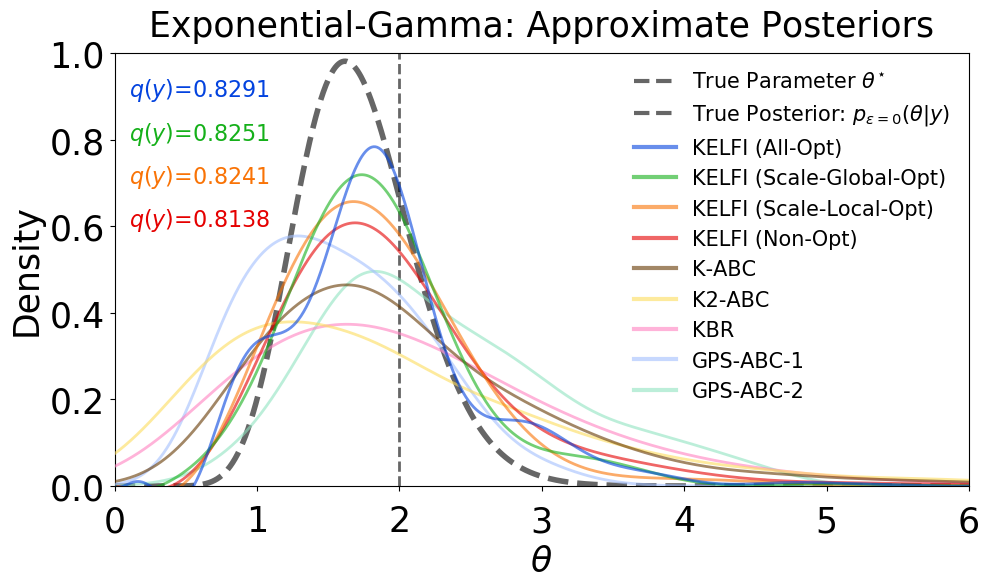

In [74]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot: True Posterior
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    # Plot: KELFI
    ax.plot(t, kmp_opt_query, c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=100, label=r'KELFI (All-Opt)')
    ax.plot(t, kmp_global_query, c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=99, label=r'KELFI (Scale-Global-Opt)')
    ax.plot(t, kmp_local_query, c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', zorder=98, alpha=0.6, label=r'KELFI (Scale-Local-Opt)')
    ax.plot(t, kmp_arb_query, c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=97, label=r'KELFI (Non-Opt)')
    
    # Plot: Other Kernel Approaches
    ax.plot(t, k1_abc_posterior_density_query, c=sns.xkcd_rgb['brown'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K-ABC')
    ax.plot(t, k2_abc_posterior_density_query, c=sns.xkcd_rgb['light gold'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=95, label='K2-ABC')
    ax.plot(t, kbr_1_abc_posterior_density_query, c=sns.xkcd_rgb['pink'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=94, label='KBR')
    ls = 0.25
    ax.plot(t, kde(gps_abc_posterior_samples_1, t_query, ls), c=sns.xkcd_rgb['pastel blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=93, label='GPS-ABC-1')
    ax.plot(t, kde(gps_abc_posterior_samples_2, t_query, ls), c=sns.xkcd_rgb['light teal'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=92, label='GPS-ABC-2')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
 
    # Aesthetics
    ax.set_xlim((t_min, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=25, y=1.02)
    ax.set_xlabel(r'$\theta$', fontsize=25)
    ax.set_ylabel(r'Density', fontsize=25)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    plt.xticks(y=-0.02)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    
temp_plot()

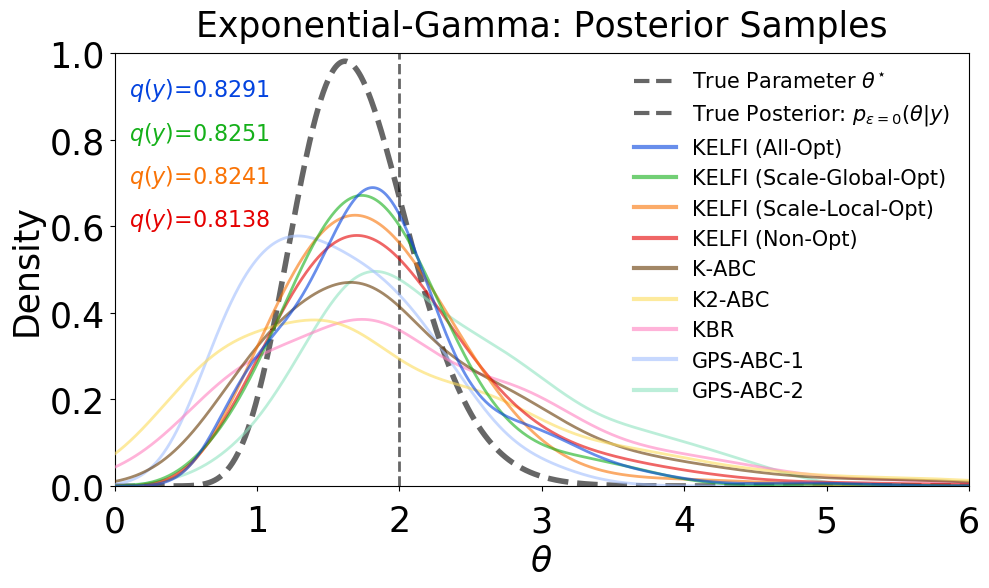

In [75]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 6))
    
    # Computations
    t = t_query.ravel()
    
    # Plot: True Posterior
    ax.axvline(theta_true, c='k', linestyle='--', linewidth=2.0, alpha=0.6, label=r'True Parameter $\theta^{\star}$')
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior: $p_{\epsilon=0}(\theta | y)$')
    
    # Plot: KELFI
    ax.plot(t, kde(t_kmpe_opt, t_query, beta_query), c=sns.xkcd_rgb['blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=100, label=r'KELFI (All-Opt)')
    ax.plot(t, kde(t_kmpe_global, t_query, beta_query), c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=99, label=r'KELFI (Scale-Global-Opt)')
    ax.plot(t, kde(t_kmpe_local, t_query, beta_query), c=sns.xkcd_rgb['orange'], linewidth=2.0, linestyle='-', zorder=98, alpha=0.6, label=r'KELFI (Scale-Local-Opt)')
    ax.plot(t, kde(t_kmpe_arb, t_query, beta_query), c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=97, label=r'KELFI (Non-Opt)')
    
    # Plot: Other Kernel Approaches
    ax.plot(t, kde(k1_abc_posterior_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['brown'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K-ABC')
    ax.plot(t, kde(k2_abc_posterior_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['light gold'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K2-ABC')
    ax.plot(t, kde(kbr_1_abc_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['pink'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=94, label='KBR')
    ls = 0.25
    ax.plot(t, kde(gps_abc_posterior_samples_1, t_query, ls), c=sns.xkcd_rgb['pastel blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=93, label='GPS-ABC-1')
    ax.plot(t, kde(gps_abc_posterior_samples_2, t_query, ls), c=sns.xkcd_rgb['light teal'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=92, label='GPS-ABC-2')
    
    # Annotations
    ax.text(0.1, 0.9, r'$q(y)$=%.4f' % mkml_opt, color=sns.xkcd_rgb['blue'], fontsize=16)
    ax.text(0.1, 0.8, r'$q(y)$=%.4f' % mkml_global, color=sns.xkcd_rgb['green'], fontsize=16)
    ax.text(0.1, 0.7, r'$q(y)$=%.4f' % mkml_local, color=sns.xkcd_rgb['orange'], fontsize=16)
    ax.text(0.1, 0.6, r'$q(y)$=%.4f' % mkml_arb, color=sns.xkcd_rgb['red'], fontsize=16)
 
    # Aesthetics
    ax.set_xlim((t_min, 6))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Posterior Samples', fontsize=25, y=1.02)
    ax.set_xlabel(r'$\theta$', fontsize=25)
    ax.set_ylabel(r'Density', fontsize=25)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    plt.xticks(y=-0.02)
    plt.tight_layout()
    leg = ax.legend(fontsize=15, loc='upper right', bbox_to_anchor=(1, 1), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    
temp_plot()

Captions: Comparisons of KELFI with other kernel-based likelihood-free inference approaches. Note that GPS-ABC-1 and GPS-ABC-2 used 130 and 197 simulations respectively, more than the 100 simulations other kernel approaches used.

The first plot shows their most direct density surrogates. KELFI uses KMP. K-ABC, K2-ABC, and KBR uses weighted samples, with weights that are not necessarily positive.

The second plot shows the posterior using their kernel herded samples.

GPS-ABC stays the same for both plots since they produce posterior samples directly.

----- 
# Deconditional Kernel Mean Embeddings for Likelihood-Free Inference

Below is the minimum code for computing deconditional kernel mean embeddings using the alternative form which is faster if there are a lot of prior samples.

Importantly, the approximate marginal likelihood for deconditional mean embeddings when used in a likelihood-free setting is by construction the same as the one used in KELFI. Hence, we will use the same learned hyperparameters from the KELFI stage for the DME solution.

In [76]:
%%file delfi.py
"""
Deconditional Kernel Mean Embeddings for Likelihood-Free Inference.

Core functions for Deconditional Embedding Likelihood-Free Inference (DELFI).
"""
import numpy as np
import scipy.linalg as la
from kernels import gaussian_kernel_gramix


def transformation_matrix(y, y_tilde, ls_y, lamb):
    """
    Compute the transformation matrix for DME/TTGP, defined as $A := (L + n \lambda I)^{-1} \tilde{L}$.
    
    This code uses Gaussian kernels only.
    
    Parameters
    ----------
    y : np.ndarray [Size: (n, d_y)]
        Samples of the mediating variable from the simulation process
    y_tilde : np.ndarray [Size: (m, d_y)]
        Samples of the mediating variable from the observation process
    ls_y : float or np.ndarray [Size: () or (1,) for isotropic; (d_y,) for anistropic]
        The length scale(s) of the mediating variable(s)
    lamb : float
        Regularization parameter
    
    Returns
    -------
    np.ndarray [Size: (n, m)]
        The transformation matrix
    """
    # Size: (n, n)
    l = gaussian_kernel_gramix(y, y, ls_y)
    # Size: (n, m)
    tilde_l = gaussian_kernel_gramix(y, y_tilde, ls_y)
    # Size: (n, n)
    n = y.shape[0]
    lower = True
    l_chol = la.cholesky(l + n * lamb * np.eye(n), lower=lower)
    # Size: (n, m)
    a = la.cho_solve((l_chol, lower), tilde_l)
    return a


def dme_query_fast(t_query, t_tilde, t, x, y, ls_t, ls_x, lamb, eps):
    """
    Compute the deconditional mean embedding using the alternative form which is cubic in simulation samples but linear in prior samples.
    
    This code uses Gaussian kernels only.
    
    Parameters
    ----------
    t_query : np.ndarray [Size: (n_q, d_t)]
        The parameters to query the deconditional mean embedding at
    t_tilde: np.ndarray [Size: (m, d_t)]
        The prior parameter samples
    t : np.ndarray [Size: (n, d_t)]
        The likelihood parameter samples
    x : np.ndarray [Size: (n, d_x)]
        The likelihood statistic samples
    y : np.ndarray [Size: (d_x,)]
        The observed statistic
    ls_t : float or np.ndarray [Size: () or (1,) for isotropic; (d_y,) for anistropic]
        The length scale(s) of the parameters
    lt_x : float or np.ndarray [Size: () or (1,) for isotropic; (d_y,) for anistropic]
        The length scale(s) of the statistics
    lamb : float
        The regularization hyperparameter for the prior operator inversion
    eps: float
        The regularization hyperparameter for the evidence operator inversion
        
    Returns
    -------
    np.ndarray [Size: (n_q, 1)]
        The deconditional mean embedding evaluated at the query parameters
    """
    m = t_tilde.shape[0]
    n = t.shape[0]
    # Size: (n, m)
    a = transformation_matrix(t, t_tilde, ls_t, lamb)
    # Size: (n, n)
    k = gaussian_kernel_gramix(x, x, ls_x)
    # Size: (n, 1)
    k_y = gaussian_kernel_gramix(x, y, ls_x)
    # Size: (m, 1)
    query_weights = np.dot(np.transpose(a), la.solve(np.dot(k, np.dot(a, np.transpose(a))) + m * eps * np.eye(n), k_y))
    # Size: (m, n_q)
    l_query = gaussian_kernel_gramix(t_tilde, t_query, ls_t)
    # Size: (n_q, 1)
    q_query = np.dot(np.transpose(l_query), query_weights)
    return q_query

Writing delfi.py


In [77]:
from delfi import dme_query_fast

In [78]:
# Those are the globally optimal hyperparameters
ls_t = beta_global
ls_x = eps_global

# For simplicity we just fix regularization parameters in this experiment
lamb = 1e-4
eps = 1e-4

# Compute the deconditional mean embedding
dme_queried = dme_query_fast(t_samples, t_samples, t_sim, s_x, s_y, ls_t, ls_x, lamb, eps)

# Obtain the posterior samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, beta_query)
dme_posterior_samples_global = kernel_herding(dme_queried.ravel(), kernel_function, t_samples, n_super_samples, init_super_samples=None)

In [79]:
# Those are the locally optimal hyperparameters
ls_t = beta_local
ls_x = eps_local

# For simplicity we just fix regularization parameters in this experiment
lamb = 1e-4
eps = 1e-4

# Compute the deconditional mean embedding
dme_queried = dme_query_fast(t_samples, t_samples, t_sim, s_x, s_y, ls_t, ls_x, lamb, eps)

# Obtain the posterior samples
n_super_samples = 10000
kernel_function = lambda t1, t2: gaussian_kernel_gramix(t1, t2, beta_query)
dme_posterior_samples_local = kernel_herding(dme_queried.ravel(), kernel_function, t_samples, n_super_samples, init_super_samples=None)

# Comparisons of Posterior Approximations

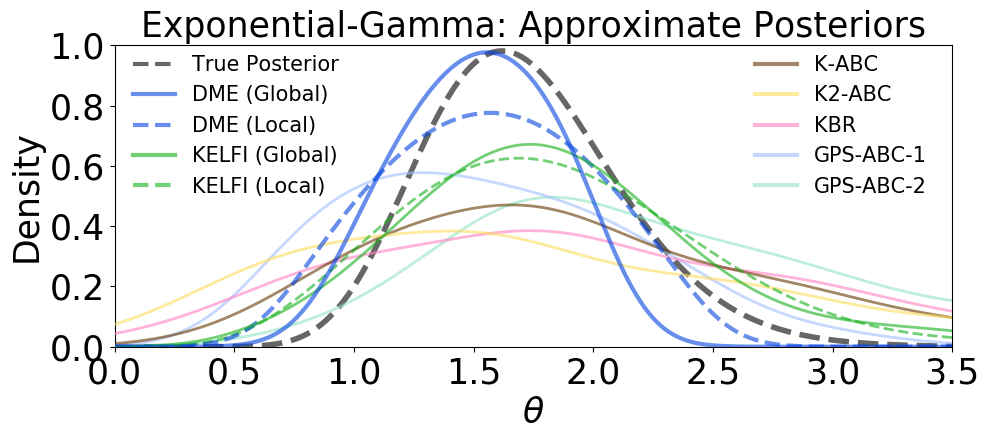

In [80]:
def temp_plot():

    # Setup
    sns.set()
    sns.reset_orig()
    fig, ax = plt.subplots(1, 1)
    fig.set_size_inches((10, 4.5))
    
    # Computations
    t = t_query.ravel()
    
    # Plot: True Posterior
    ax.plot(t, posterior_pdf(t, y_data[0]), c='k', linestyle='--', linewidth=4.0, alpha=0.6, label=r'True Posterior')
    
    # Plot: DME
    ax.plot(t, kde(dme_posterior_samples_global, t[:, np.newaxis], beta_query), c=sns.xkcd_rgb['blue'], linewidth=3.0, linestyle='-', alpha=0.6, label=r'DME (Global)', zorder=100)
    ax.plot(t, kde(dme_posterior_samples_local, t[:, np.newaxis], beta_query), c=sns.xkcd_rgb['blue'], linewidth=3.0, linestyle='--', alpha=0.6, label=r'DME (Local)', zorder=99)

    # Plot: KELFI
    # ax.plot(t, kde(t_kmpe_opt, t_query, beta_query), c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=100, label=r'KELFI (All-Opt)')
    ax.plot(t, kde(t_kmpe_global, t_query, beta_query), c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=99, label=r'KELFI (Global)')
    ax.plot(t, kde(t_kmpe_local, t_query, beta_query), c=sns.xkcd_rgb['green'], linewidth=2.0, linestyle='--', zorder=98, alpha=0.6, label=r'KELFI (Local)')
    # ax.plot(t, kde(t_kmpe_arb, t_query, beta_query), c=sns.xkcd_rgb['red'], linewidth=2.0, linestyle='--', alpha=0.6, zorder=97, label=r'KELFI (Non-Opt)')
    
    # Plot: Other Kernel Approaches
    ax.plot(t, kde(k1_abc_posterior_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['brown'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K-ABC')
    ax.plot(t, kde(k2_abc_posterior_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['light gold'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=96, label='K2-ABC')
    ax.plot(t, kde(kbr_1_abc_samples, t_query, ls_t_vis), c=sns.xkcd_rgb['pink'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=94, label='KBR')
    ls = 0.25
    ax.plot(t, kde(gps_abc_posterior_samples_1, t_query, ls), c=sns.xkcd_rgb['pastel blue'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=93, label='GPS-ABC-1')
    ax.plot(t, kde(gps_abc_posterior_samples_2, t_query, ls), c=sns.xkcd_rgb['light teal'], linewidth=2.0, linestyle='-', alpha=0.6, zorder=92, label='GPS-ABC-2')
    
    # Aesthetics
    ax.set_xlim((0, 3.5))
    ax.set_ylim((0, 1))
    ax.set_title(r'Exponential-Gamma: Approximate Posteriors', fontsize=25)
    ax.set_xlabel(r'$\theta$', fontsize=25)
    ax.set_ylabel(r'Density', fontsize=25)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(25) 
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(25)
    plt.tight_layout()
    leg = ax.legend(ncol=2, columnspacing=20, fontsize=15, loc='upper left', bbox_to_anchor=(0, 1.03), frameon=False)
    for legobj in leg.legendHandles:
        legobj.set_linewidth(3.0)
    fig.savefig('likelihood-free-inference-exponential-gamma.pdf', format='pdf', dpi=1000)
    
temp_plot()

# Package Versions

    >> pip freeze
    absl-py==0.1.9
    astor==0.6.2
    autograd==1.2
    bleach==1.5.0
    boto3==1.7.10
    botocore==1.10.10
    cachetools==2.0.1
    certifi==2018.4.16
    chardet==3.0.4
    colorama==0.3.9
    cycler==0.10.0
    decorator==4.2.1
    dill==0.2.7.1
    docutils==0.14
    entrypoints==0.2.3
    enum34==1.1.6
    et-xmlfile==1.0.1
    future==0.16.0
    gapic-google-cloud-datastore-v1==0.15.3
    gapic-google-cloud-error-reporting-v1beta1==0.15.3
    gapic-google-cloud-logging-v2==0.91.3
    gast==0.2.0
    ghalton==0.6.1
    google-api-core==0.1.4
    google-auth==1.4.1
    google-cloud==0.32.0
    google-cloud-bigquery==0.28.0
    google-cloud-bigquery-datatransfer==0.1.1
    google-cloud-bigtable==0.28.1
    google-cloud-container==0.1.1
    google-cloud-core==0.28.1
    google-cloud-dataproc==0.1.0
    google-cloud-datastore==1.4.0
    google-cloud-dns==0.28.0
    google-cloud-error-reporting==0.28.0
    google-cloud-firestore==0.28.0
    google-cloud-language==1.0.1
    google-cloud-logging==1.4.0
    google-cloud-monitoring==0.28.1
    google-cloud-pubsub==0.30.1
    google-cloud-resource-manager==0.28.1
    google-cloud-runtimeconfig==0.28.1
    google-cloud-spanner==0.29.0
    google-cloud-speech==0.30.0
    google-cloud-storage==1.6.0
    google-cloud-trace==0.17.0
    google-cloud-translate==1.3.1
    google-cloud-videointelligence==1.0.1
    google-cloud-vision==0.29.0
    google-gax==0.15.16
    google-resumable-media==0.3.1
    googleapis-common-protos==1.5.3
    graphviz==0.9
    grpc-google-iam-v1==0.11.4
    grpcio==1.11.0
    html5lib==0.9999999
    httplib2==0.11.3
    idna==2.6
    imageio==2.4.1
    ipykernel==4.8.0
    ipython==6.2.1
    ipython-genutils==0.2.0
    ipywidgets==7.1.0
    jdcal==1.3
    jedi==0.11.1
    Jinja2==2.10
    jmespath==0.9.3
    jsonschema==2.6.0
    jupyter==1.0.0
    jupyter-client==5.2.1
    jupyter-console==5.2.0
    jupyter-core==4.4.0
    kiwisolver==1.0.1
    Markdown==2.6.11
    MarkupSafe==1.0
    matplotlib==2.2.2
    mistune==0.8.3
    mrjob==0.6.2
    nbconvert==5.3.1
    nbformat==4.4.0
    nltk==3.2.5
    notebook==5.3.1
    numpy==1.14.2
    oauth2client==3.0.0
    openpyxl==2.5.0
    pandas==0.22.0
    pandocfilters==1.4.2
    parso==0.1.1
    patsy==0.5.0
    pickleshare==0.7.4
    Pillow==5.1.0
    ply==3.8
    prompt-toolkit==1.0.15
    proto-google-cloud-datastore-v1==0.90.4
    proto-google-cloud-error-reporting-v1beta1==0.15.3
    proto-google-cloud-logging-v2==0.91.3
    protobuf==3.5.1
    psutil==5.4.5
    pyasn1==0.4.2
    pyasn1-modules==0.2.1
    Pygments==2.2.0
    pyparsing==2.2.0
    pyreadline==2.1
    python-dateutil==2.6.1
    pytz==2017.3
    pywinpty==0.5.1
    PyYAML==3.12
    pyzmq==16.0.3
    qtconsole==4.3.1
    requests==2.18.4
    rsa==3.4.2
    s3transfer==0.1.13
    scikit-learn==0.19.1
    scipy==1.0.1
    seaborn==0.8.1
    Send2Trash==1.4.2
    simplegeneric==0.8.1
    six==1.11.0
    sklearn==0.0
    statsmodels==0.8.0
    style==1.1.0
    tensorflow-gpu==1.5.0
    tensorflow-tensorboard==1.5.1
    termcolor==1.1.0
    terminado==0.8.1
    testpath==0.3.1
    tornado==4.5.3
    traitlets==4.3.2
    update==0.0.1
    urllib3==1.22
    wcwidth==0.1.7
    Werkzeug==0.14.1
    widgetsnbextension==3.1.0
    wordcloud==1.4.1
    xlrd==1.1.0